In [1]:
import torch
import os
import matplotlib.pyplot as plt
import cv2
from PIL import Image
from tqdm import tqdm 
import numpy as np
import pandas as pd 
from glob import glob
import random
import json
import PIL
import pickle

In [2]:
import pandas as pd
from PIL import Image
from torchvision.datasets import VisionDataset
from torchvision import transforms
import torchvision
from torchvision.transforms import v2
    
from isic_dataset import SpuriousDermDataset

/data/healthy-ml/scratch/qixuanj/anaconda3/envs/control/lib/python3.8/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


# Initial visualize

In [45]:
# filepath = "/data/scratch/wgerych/spurious_ISIC/" #PATH_TO_SPURIOUS_ISIC 
filepath = "/data/scratch/wgerych/spurious_ISIC_ruler_no_patches/"
# filepath = "/data/scratch/wgerych/spurious_ISIC_ink/"

# train_dataset = spuriousDermDataset(file_path=filepath, split='train', transform=transform)
# test_dataset = spuriousDermDataset(file_path=filepath, split='extra', transform=transform)
# val_dataset = spuriousDermDataset(file_path=filepath, split='val', transform=transform)
# extra_dataset = spuriousDermDataset(file_path=filepath, split='test', transform=transform)


prev_train_dataset = SpuriousDermDataset(file_path=filepath, split='train')
extra_dataset = SpuriousDermDataset(file_path=filepath, split='extra')
prev_val_dataset = SpuriousDermDataset(file_path=filepath, split='val')
test_dataset = SpuriousDermDataset(file_path=filepath, split='test')
print(len(prev_train_dataset))
print(len(extra_dataset))
print(len(prev_val_dataset))
print(len(test_dataset))

870
1031
219
280


In [46]:
add_indices = list(prev_val_dataset.metadata_for_split.sample(n=len(prev_val_dataset) - 50, random_state=0).index)

In [47]:
val_indices = list(set(prev_val_dataset.metadata_for_split.index) - set(add_indices))

In [48]:
val_dataset = torch.utils.data.Subset(prev_val_dataset, val_indices) 
add_dataset = torch.utils.data.Subset(prev_val_dataset, add_indices)
train_dataset = torch.utils.data.ConcatDataset([add_dataset, prev_train_dataset])
print(len(train_dataset))
print(len(val_dataset))

1039
50


In [50]:
classes = []
for sample in tqdm(train_dataset): 
    classes.append(sample[2])

100%|██████████████████████████████████████████████████████████████████████| 1039/1039 [01:48<00:00,  9.54it/s]


In [51]:
print(np.unique(classes, return_counts=True))

(array([0, 3]), array([228, 811]))


In [33]:
prev_train_dataset.metadata_for_split['class'].value_counts()

class
3    680
0    190
Name: count, dtype: int64

In [14]:
class1 = list(extra_dataset.metadata_for_split[extra_dataset.metadata_for_split['class'] == 1].sample(n=10, random_state=0).index)
class2 = list(extra_dataset.metadata_for_split[extra_dataset.metadata_for_split['class'] == 2].sample(n=10, random_state=0).index)

In [16]:
new_extra_dataset = torch.utils.data.Subset(extra_dataset, class1 + class2) 
print(len(new_extra_dataset))

20


In [9]:
# Subset extra_dataset to 100 per -> test with dreambooth diffusion 
groups = extra_dataset.metadata_for_split['class']
group1_indices = groups[groups == 1].iloc[:50].index
group2_indices = groups[groups == 2].iloc[:50].index

In [13]:
group1 = torch.utils.data.Subset(extra_dataset, group1_indices)
group2 = torch.utils.data.Subset(extra_dataset, group2_indices)
print(len(group1))
print(len(group2))
mix_dataset = torch.utils.data.ConcatDataset([group1, group2])
print(len(mix_dataset))

50
50
100


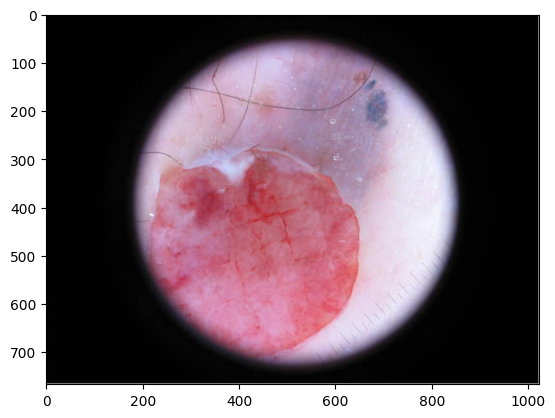

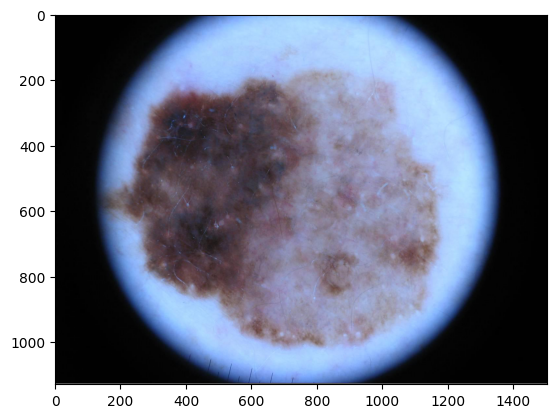

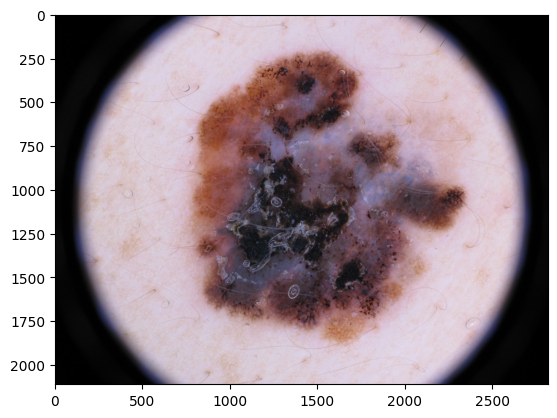

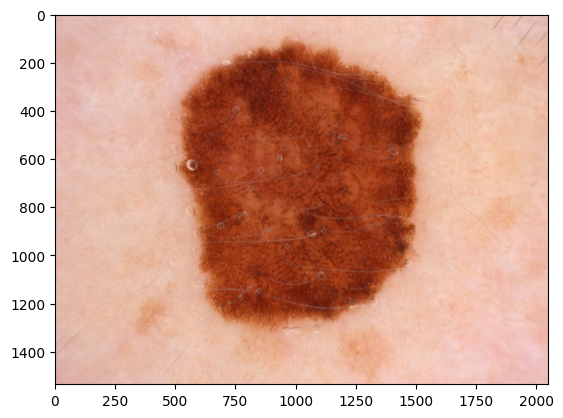

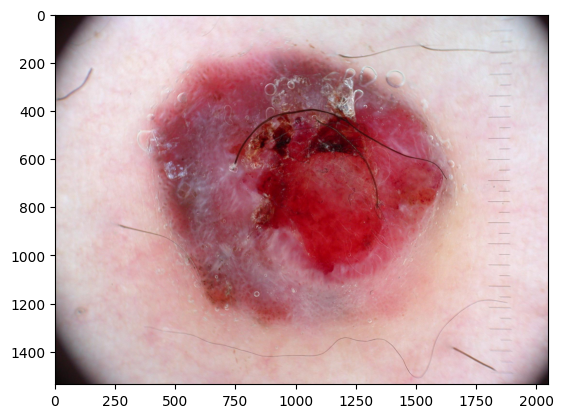

...

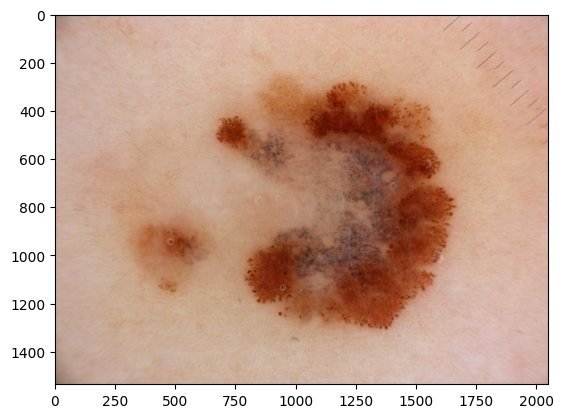

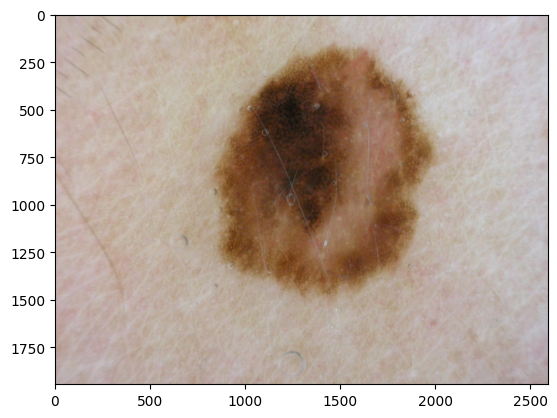

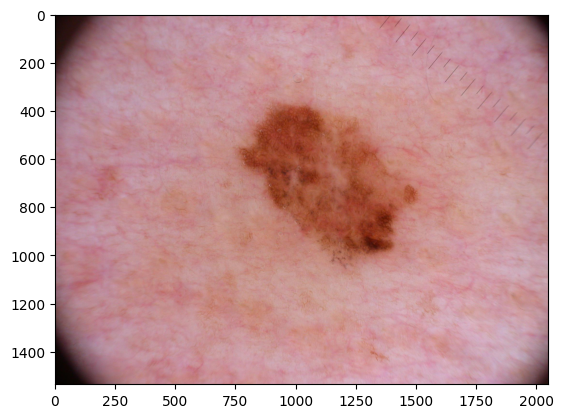

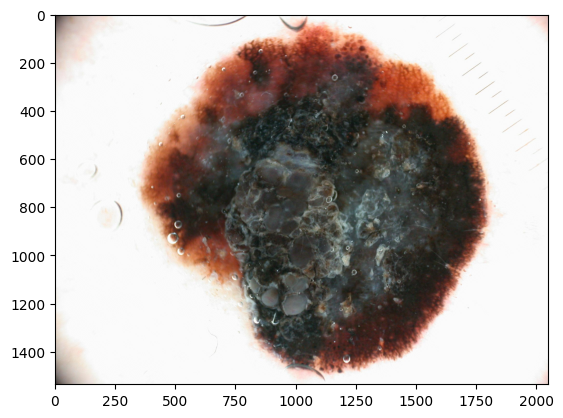

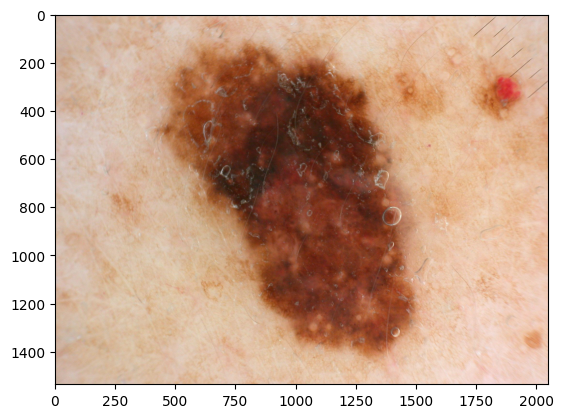

In [29]:
# 0: malignant with marking 1: malignant without marking 2: benign with marking 3: benign without marking 
# Visualize and check 

count_0 = 0 
for i in range(len(train_dataset)): 
    img, melanoma_label, group_label = train_dataset[i]
    if group_label == 0: 
        plt.imshow(img)
        plt.show()
        count_0 += 1
    if count_0 > 10: 
        break

In [ ]:
for i in tqdm(range(len(train_dataset))): 
    _, _, group_label = train_dataset[i]
    if group_label == 1 or group_label == 2: 
        print("error!") 
        break 

# Debug diffusion dataset

In [946]:
root = "/data/scratch/wgerych/spurious_ISIC_ruler_no_patches/"
train_ds = SpuriousDermDataset(file_path=root, split="train")
val_ds = SpuriousDermDataset(file_path=root, split="val")

In [953]:
train_benign = np.where(train_ds.metadata_for_split['benign_malignant'] == 'benign')[0]
train_malignant = np.where(train_ds.metadata_for_split['benign_malignant'] == 'malignant')[0]
print(len(train_benign))
print(len(train_malignant))

680
190


In [954]:
val_benign = np.where(val_ds.metadata_for_split['benign_malignant'] == 'benign')[0]
val_malignant = np.where(val_ds.metadata_for_split['benign_malignant'] == 'malignant')[0]
print(len(val_benign))
print(len(val_malignant))

171
48


In [955]:
benign = torch.utils.data.ConcatDataset([torch.utils.data.Subset(train_ds, train_benign), 
                                torch.utils.data.Subset(val_ds, val_benign)])
print(len(benign))

851


In [956]:
malignant = torch.utils.data.ConcatDataset([torch.utils.data.Subset(train_ds, train_malignant), 
                                            torch.utils.data.Subset(val_ds, val_malignant)])
print(len(malignant))

238


# Remove the dots (shortcut for diffusion model) 

In [40]:
from isic_dataset import SpuriousDermDataset

In [44]:
train_dataset = SpuriousDermDataset(file_path=filepath, split='train')
prev_extra_dataset = SpuriousDermDataset(file_path=filepath, split='extra')

groups = prev_extra_dataset.metadata_for_split['class']
group1_indices = groups[groups == 1].iloc[:50].index
group2_indices = groups[groups == 2].iloc[:50].index
group1 = torch.utils.data.Subset(prev_extra_dataset, group1_indices)
group2 = torch.utils.data.Subset(prev_extra_dataset, group2_indices)
extra_dataset = torch.utils.data.ConcatDataset([group1, group2])

train_dataloader = torch.utils.data.DataLoader(train_dataset, batch_size=8, shuffle=True)
prev_extra_dataloader = torch.utils.data.DataLoader(prev_extra_dataset, batch_size=8, shuffle=True)
extra_dataloader = torch.utils.data.DataLoader(extra_dataset, batch_size=8, shuffle=True)

In [45]:
print(len(train_dataset))
print(len(prev_extra_dataset))
print(len(extra_dataset))

1046
1079
100


In [48]:
df = train_dataset.metadata_for_split 

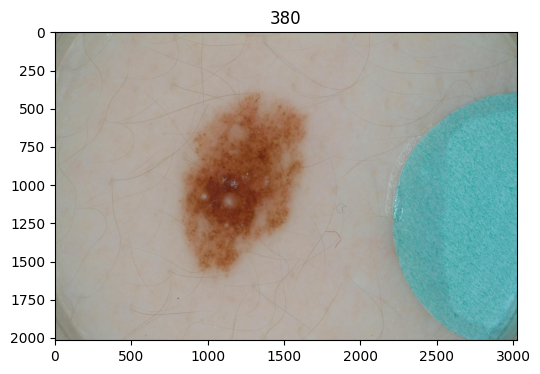

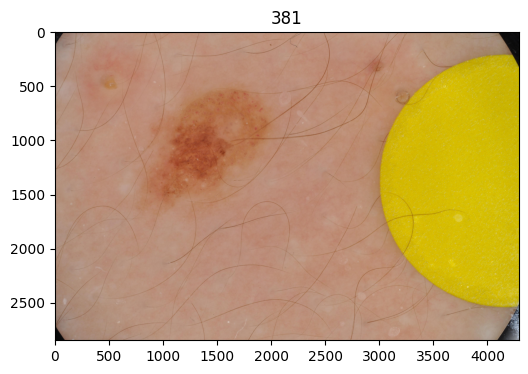

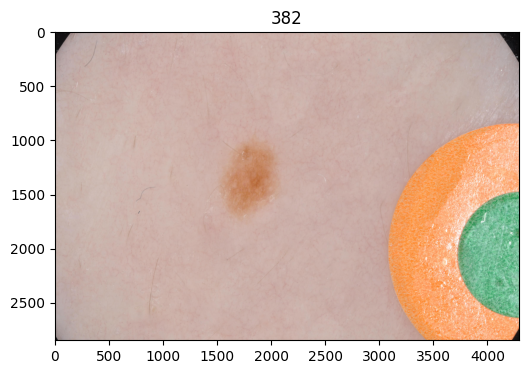

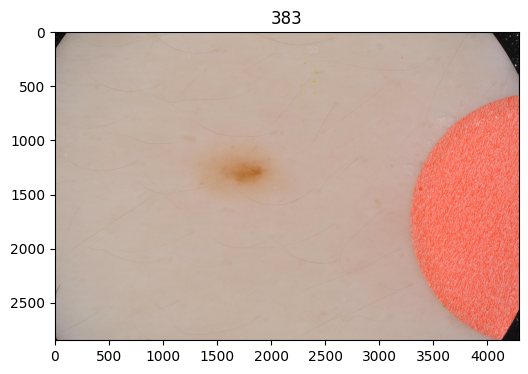

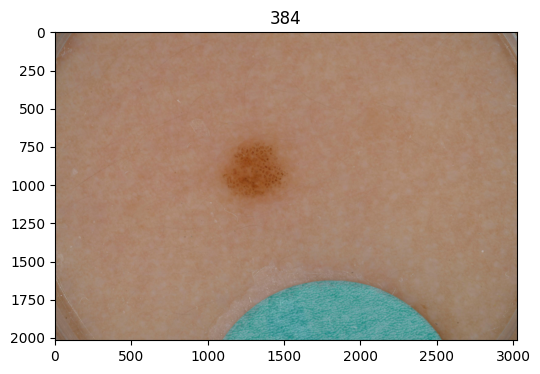

...

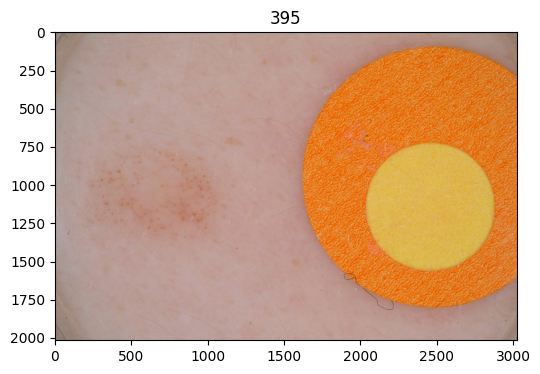

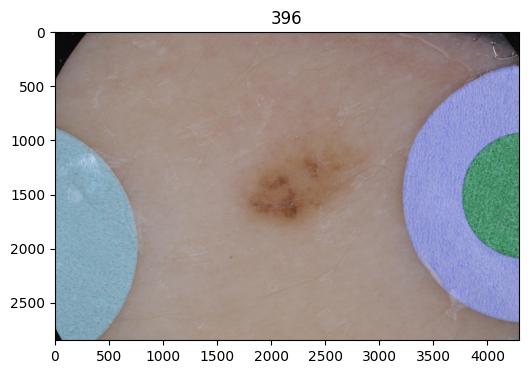

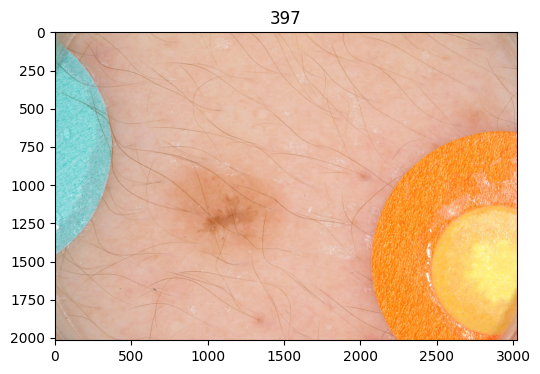

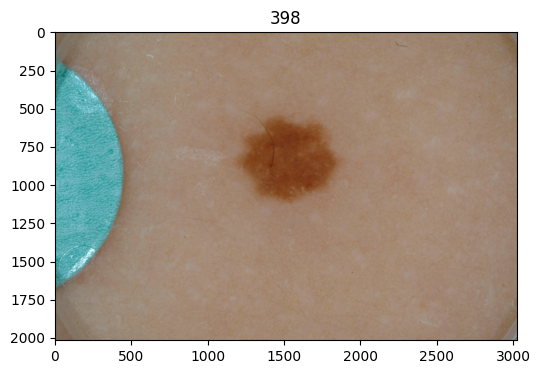

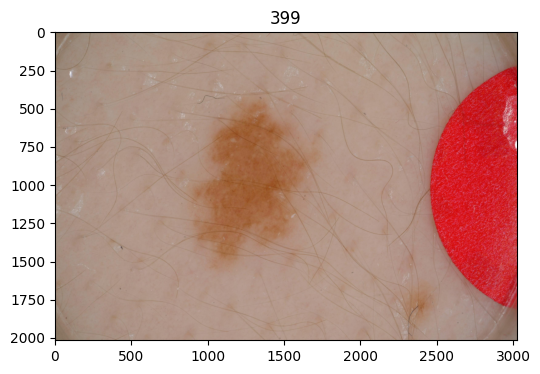

In [94]:
offset = 380
max_index = min(offset + 20, len(df))
for i in range(offset, max_index): 
    img = Image.open(filepath + "/" + df['image'].iloc[i])
    plt.figure(figsize=(6, 4))
    plt.imshow(img)
    plt.title(f"{i}")
    plt.show()

# Base Stable Diffusion generation

In [14]:
from diffusers import DiffusionPipeline

model_id = "runwayml/stable-diffusion-v1-5"
pipe = DiffusionPipeline.from_pretrained(model_id, torch_dtype=torch.float16)
pipe = pipe.to("cuda")

Loading pipeline components...: 100%|████████████████████████████████████████████| 7/7 [01:10<00:00, 10.07s/it]


100%|██████████████████████████████████████████████████████████████████████████| 50/50 [00:02<00:00, 24.60it/s]


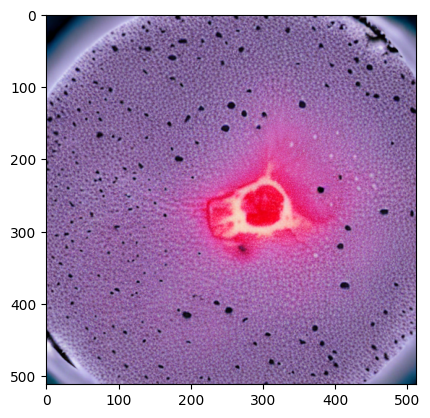

In [19]:
prompt = f"a dermoscopic image of malignant-source skin lesion"
image1 = pipe(prompt=prompt, 
             # negative_prompt=''' two birds, pixelated, blurry, jpeg artifacts, low quality, 
             #                     cartoon, artwork, cgi, illustration, painting, overexposed, 
             #                     grayscale, grainy, white spots, multiple angles, ''',
             strength=0.9,
             guidance_scale=20,
             num_inference_steps=50, ).images[0]
plt.imshow(image1)
plt.show()

100%|██████████████████████████████████████████████████████████████████████████| 50/50 [00:02<00:00, 21.76it/s]


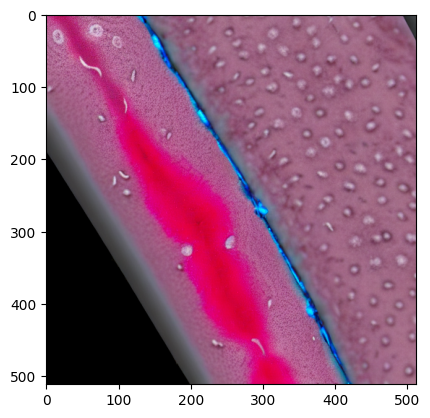

In [34]:
prompt = f"a dermoscopic image of benign-source skin lesion"
image1 = pipe(prompt=prompt, 
             # negative_prompt=''' two birds, pixelated, blurry, jpeg artifacts, low quality, 
             #                     cartoon, artwork, cgi, illustration, painting, overexposed, 
             #                     grayscale, grainy, white spots, multiple angles, ''',
             strength=0.9,
             guidance_scale=20,
             num_inference_steps=50, ).images[0]
plt.imshow(image1)
plt.show()

# Textual Inversion Dataset

In [225]:
import subprocess

In [958]:
output_dir = "/mnt/scratch-lids/scratch/qixuanj/inversion_datasets/isic"

In [959]:
filepath = "/data/scratch/wgerych/spurious_ISIC_ruler_no_patches/"
prev_train_dataset = SpuriousDermDataset(file_path=filepath, split='train')
extra_dataset = SpuriousDermDataset(file_path=filepath, split='extra')

prev_val_dataset = SpuriousDermDataset(file_path=filepath, split='val')
class1 = list(extra_dataset.metadata_for_split[extra_dataset.metadata_for_split['class'] == 1].sample(n=50, random_state=0).index)
class2 = list(extra_dataset.metadata_for_split[extra_dataset.metadata_for_split['class'] == 2].sample(n=50, random_state=0).index)
df_extra = extra_dataset.metadata_for_split.iloc[class1 + class2]

df_prev_train = prev_train_dataset.metadata_for_split
df_add = prev_val_dataset.metadata_for_split.iloc[add_indices]
df_train = pd.concat([df_prev_train, df_add], axis=0)

In [858]:
prev_train_dataset.metadata_for_split['class'].value_counts()

class
3    680
0    190
Name: count, dtype: int64

In [960]:
print(len(df_extra))
print(len(df_train))

100
1039


In [967]:
df_train['class'].value_counts()

class
3    811
0    228
Name: count, dtype: int64

In [963]:
df_extra['class'].value_counts()

class
1    50
2    50
Name: count, dtype: int64

In [232]:
# Non class attribute based 

# for i in range(len(df_train)): 
#     index = df_train.index[i]
#     old_path = filepath + df_train['image'].iloc[i]
#     token = 'source'
#     save_dir = output_dir + f'/{token}'
#     if not os.path.exists(save_dir): 
#         os.makedirs(save_dir)
#     new_path = save_dir + f'/img{index}.jpg'

#     command = f'ln -sf {old_path} {new_path}'
#     subprocess.call(command, shell=True, executable='/bin/bash',)

for i in range(len(df_extra)): 
    index = df_extra.index[i]
    old_path = filepath + df_extra['image'].iloc[i]
    token = 'target100'
    save_dir = output_dir + f'/{token}'
    if not os.path.exists(save_dir): 
        os.makedirs(save_dir)
    new_path = save_dir + f'/img{index}.jpg'

    command = f'ln -sf {old_path} {new_path}'
    subprocess.call(command, shell=True, executable='/bin/bash',)

In [965]:
len(df_train)

1039

In [966]:
# Class attribute based 

for i in range(len(df_train)): 
    index = df_train.index[i]
    class_name = df_train['benign_malignant'].iloc[i]
    old_path = filepath + df_train['image'].iloc[i]
    token = f'{class_name}-source'
    save_dir = output_dir + f'/{token}'
    if not os.path.exists(save_dir): 
        os.makedirs(save_dir)
    new_path = save_dir + f'/img{i}.jpg'

    command = f'ln -sf {old_path} {new_path}'
    subprocess.call(command, shell=True, executable='/bin/bash',)

# for i in range(len(df_extra)): 
#     index = df_extra.index[i]
#     class_name = df_extra['benign_malignant'].iloc[i]
#     old_path = filepath + df_extra['image'].iloc[i]
    
#     token = f'{class_name}-target'
#     save_dir = output_dir + f'/{token}'
#     if not os.path.exists(save_dir): 
#         os.makedirs(save_dir)
#     new_path = save_dir + f'/img{index}.jpg'

#     command = f'ln -sf {old_path} {new_path}'
#     subprocess.call(command, shell=True, executable='/bin/bash',)

In [ ]:
# The extra has other features that confound 

In [288]:
from diffusers import StableDiffusionInpaintPipeline
from diffusers import UNet2DConditionModel

model_id = "runwayml/stable-diffusion-v1-5"
# pipe = StableDiffusionInpaintPipeline.from_pretrained(model_id, dtype=torch.bfloat16, safety_checker=None,)


file_prefix = f"/mnt/scratch-lids/scratch/qixuanj/isic_sd_base_no_patches/checkpoint-2000"
unet = UNet2DConditionModel.from_pretrained(f"{file_prefix}/unet")
pipe = StableDiffusionInpaintPipeline.from_pretrained(model_id, unet=unet, dtype=torch.bfloat16, safety_checker=None,)
pipe.to("cuda")

Keyword arguments {'dtype': torch.bfloat16} are not expected by StableDiffusionInpaintPipeline and will be ignored.
Loading pipeline components...: 100%|███████████████████████████████████████████████████████████████████████████████████████████| 6/6 [00:00<00:00, 10.00it/s]
You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion_inpaint.StableDiffusionInpaintPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


StableDiffusionInpaintPipeline {
  "_class_name": "StableDiffusionInpaintPipeline",
  "_diffusers_version": "0.28.0.dev0",
  "_name_or_path": "runwayml/stable-diffusion-v1-5",
  "feature_extractor": [
    "transformers",
    "CLIPImageProcessor"
  ],
  "image_encoder": [
    null,
    null
  ],
  "requires_safety_checker": true,
  "safety_checker": [
    null,
    null
  ],
  "scheduler": [
    "diffusers",
    "PNDMScheduler"
  ],
  "text_encoder": [
    "transformers",
    "CLIPTextModel"
  ],
  "tokenizer": [
    "transformers",
    "CLIPTokenizer"
  ],
  "unet": [
    "diffusers",
    "UNet2DConditionModel"
  ],
  "vae": [
    "diffusers",
    "AutoencoderKL"
  ]
}

In [257]:
from simple_lama_inpainting import SimpleLama
simple_lama = SimpleLama()

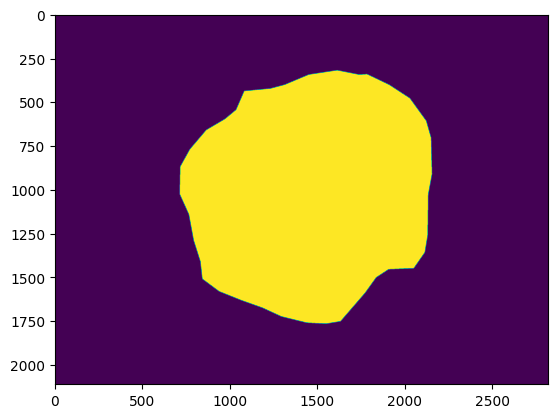

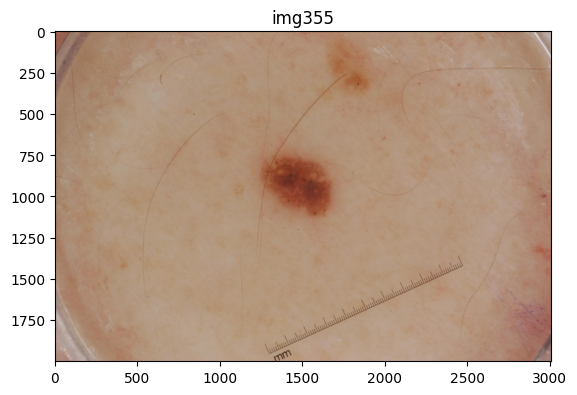

In [517]:
# Fill in with background 
filepath = "/data/scratch/wgerych/spurious_ISIC_ruler_no_patches/"

# forward until 32 
# backward until 73 
i = 73

index = df_extra.index[i]
class_name = df_extra['benign_malignant'].iloc[i]
save_dir = output_dir + f'/target100'
new_path = save_dir + f'/img{index}.jpg'

mask_mod = Image.open(filepath + df_extra['mask'].iloc[i]).convert("L")
plt.imshow(mask)
plt.show()

img = Image.open(new_path)
plt.title(f'img{index}')
plt.imshow(img)
plt.show()

In [504]:
# img.save(f"/mnt/scratch-lids/scratch/qixuanj/inversion_datasets/isic/target100background/img{i}.jpg")

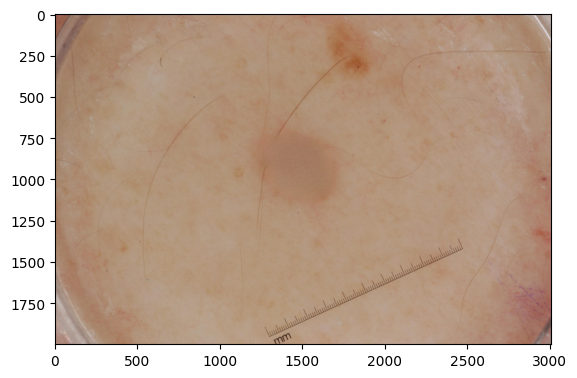

In [518]:
lama_img = simple_lama(img, mask_mod)
plt.imshow(lama_img)
plt.show()

In [486]:
# lama_img.save(f"/mnt/scratch-lids/scratch/qixuanj/inversion_datasets/isic/target100background/img{i}.jpg")

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 45/45 [00:15<00:00,  2.93it/s]


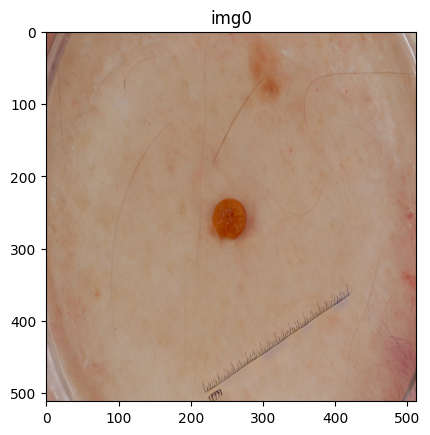

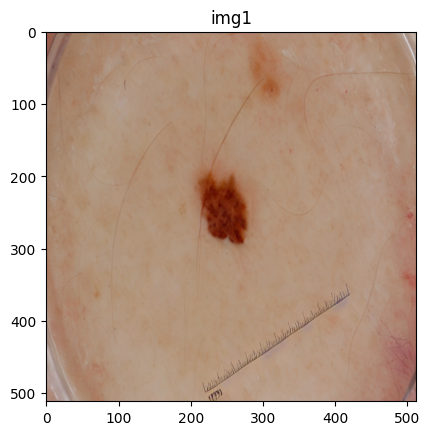

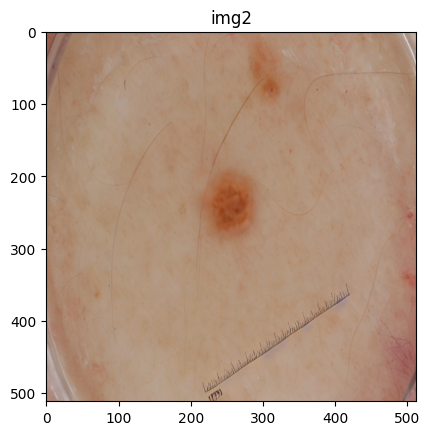

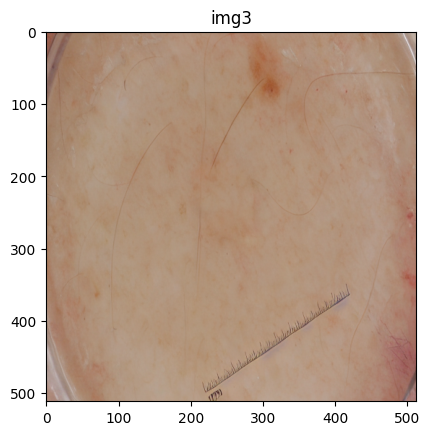

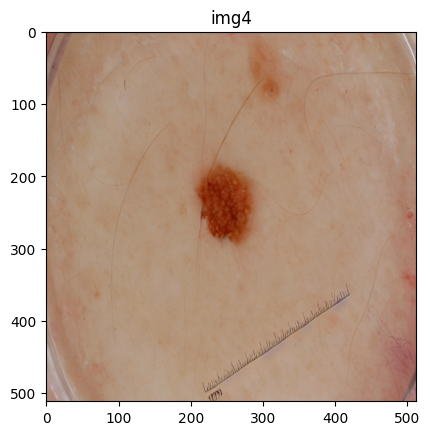

In [519]:
prompt = f"skin"
images = pipe(prompt=prompt, 
             negative_prompt=''' green, blue, brown, black, person, dancer, face, hair product, 
                                 pixelated, blurry, jpeg artifacts, low quality, 
                                 cartoon, artwork, cgi, illustration, painting, overexposed, 
                                 grayscale, grainy, multiple angles, ''',
             image=lama_img, 
             mask_image=mask_mod, 
             strength=0.9,
             guidance_scale=15,
             num_inference_steps=50,
             num_images_per_prompt=5)
for j, image in enumerate(images.images): 
    plt.title(f"img{j}")
    plt.imshow(image)
    plt.show()

In [520]:
best = 3
images.images[best].save(f"/mnt/scratch-lids/scratch/qixuanj/inversion_datasets/isic/target100background/img{i}.jpg")

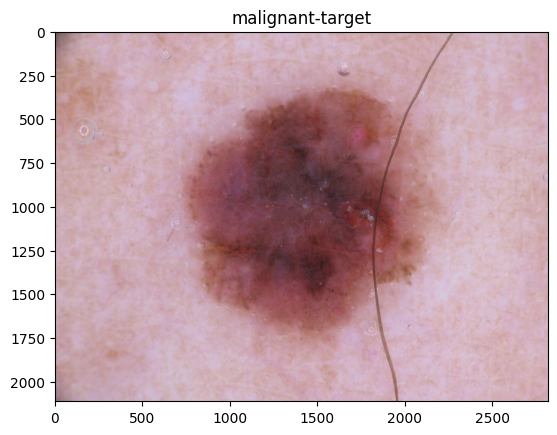

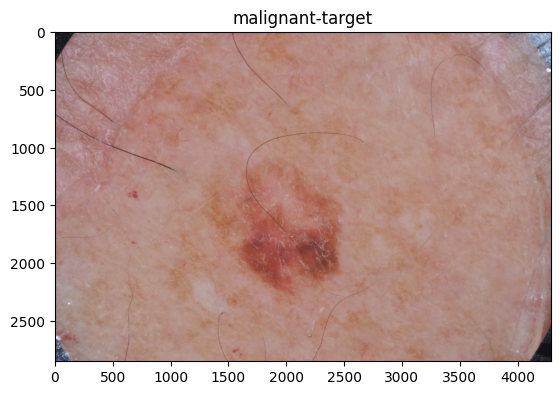

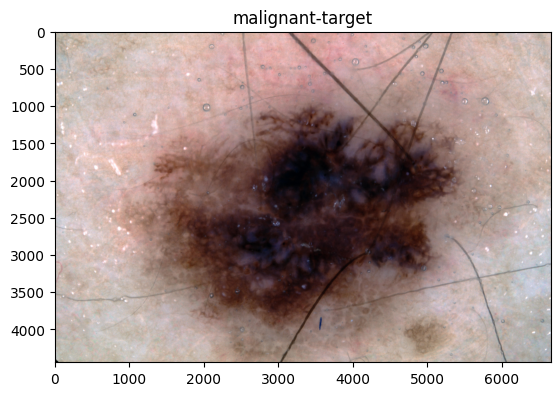

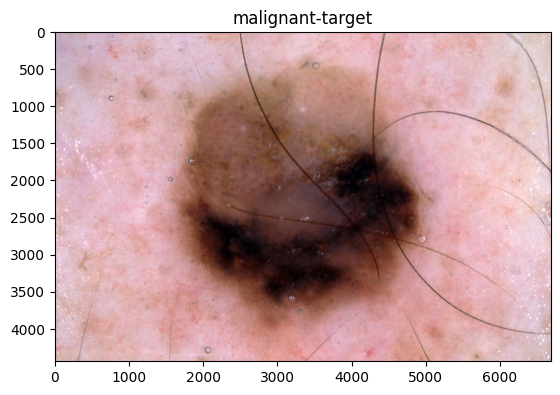

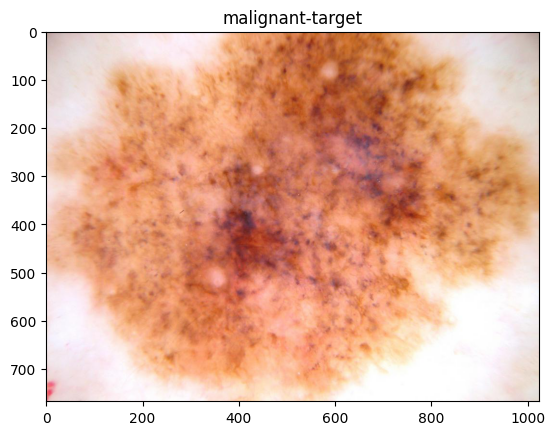

...

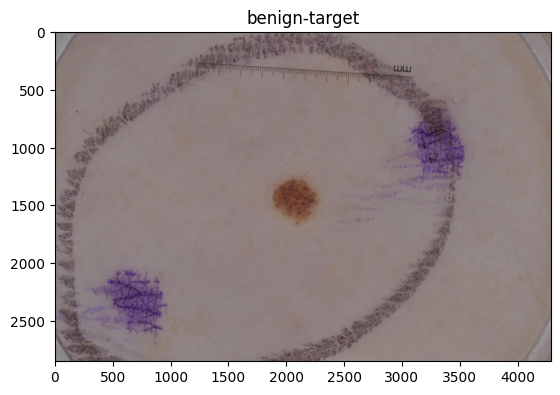

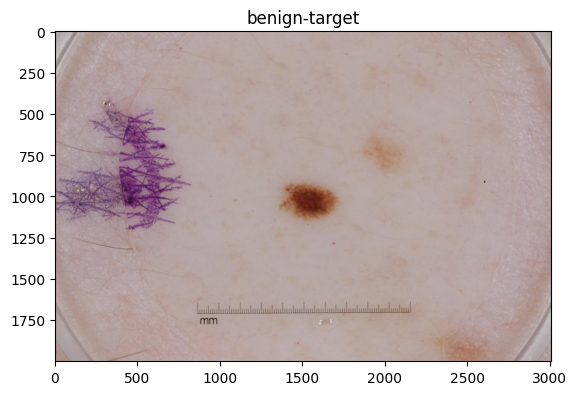

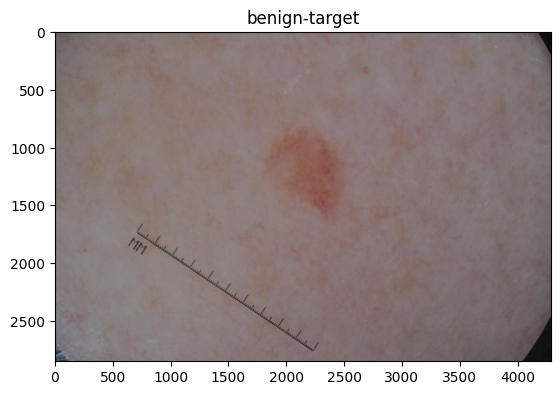

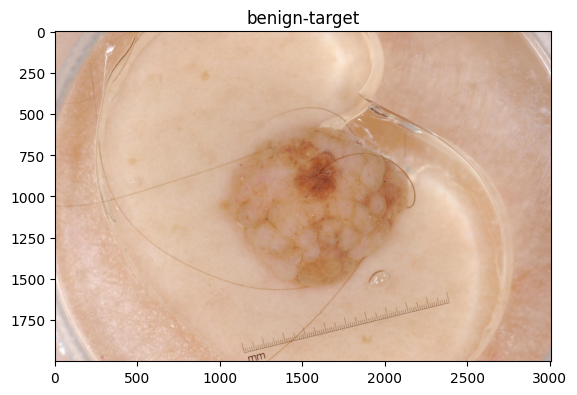

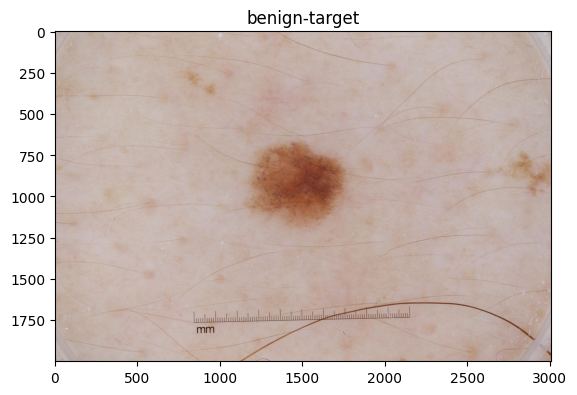

In [84]:
# Visualize all 
for i in range(len(df_extra)): 
    index = df_extra.index[i]
    class_name = df_extra['benign_malignant'].iloc[i]
    token = f'{class_name}-target'
    save_dir = output_dir + f'/{token}'
    new_path = save_dir + f'/img{index}.jpg'

    img = Image.open(new_path)
    plt.title(token)
    plt.imshow(img)
    plt.show()

In [300]:
df_extra

,isic_id,image,class,benign_malignant,mask,sex,age_approx,pixels_x,pixels_y
35,ISIC_0000139,extra/ISIC_0000139.JPG,1,malignant,extra_mask/ISIC_0000139_segmentation.png,NaN,NaN,2816,2112
831,ISIC_0014291,extra/ISIC_0014291.JPG,1,malignant,extra_mask/ISIC_0014291_segmentation.png,male,60.0,4288,2848
908,ISIC_0015109,extra/ISIC_0015109.JPG,1,malignant,extra_mask/ISIC_0015109_segmentation.png,male,40.0,6661,4441
895,ISIC_0014946,extra/ISIC_0014946.JPG,1,malignant,extra_mask/ISIC_0014946_segmentation.png,male,65.0,6688,4439
60,ISIC_0000288,extra/ISIC_0000288.JPG,1,malignant,extra_mask/ISIC_0000288_segmentation.png,female,70.0,1024,768
...,...,...,...,...,...,...,...,...,...
160,ISIC_0010025,extra/ISIC_0010025.JPG,2,benign,extra_mask/ISIC_0010025_segmentation.png,male,50.0,1024,768
742,ISIC_0013778,extra/ISIC_0013778.JPG,2,benign,extra_mask/ISIC_0013778_segmentation.png,male,55.0,4288,2848
396,ISIC_0012475,extra/ISIC_0012475.JPG,2,benign,extra_mask/ISIC_0012475_segmentation.png,male,65.0,4288,2848
948,ISIC_0015957,extra/ISIC_0015957.JPG,2,benign,extra_mask/ISIC_0015957_segmentation.png,female,40.0,3872,2592


## Custom select images for dreambooth

In [86]:
malignant_no = extra_dataset.metadata_for_split[extra_dataset.metadata_for_split['class'] == 1]

In [89]:
print(len(malignant_no))

139


In [93]:
benign_yes = extra_dataset.metadata_for_split[extra_dataset.metadata_for_split['class'] == 2]

In [94]:
print(len(benign_yes))

892


In [112]:
malignant_no_indices = [2, 6, 10, 63, 64, 66, 75, 78, 100, 105]
print(len(malignant_no_indices))
benign_yes_indices = [15, 89, 91, 183, 196, 200, 216, 300, 312, 710]
print(len(benign_yes_indices))

10
10


In [113]:
token = f'malignant-target_v2'
save_dir = output_dir + f'/{token}'
if not os.path.exists(save_dir): 
    os.makedirs(save_dir)
    
for i in malignant_no_indices: 
    class_name = malignant_no['benign_malignant'].iloc[i]
    old_path = filepath + malignant_no['image'].iloc[i]
    
    new_path = save_dir + f'/img{i}.jpg'

    command = f'ln -sf {old_path} {new_path}'
    subprocess.call(command, shell=True, executable='/bin/bash',)

In [114]:
token = f'benign-target_v2'
save_dir = output_dir + f'/{token}'
if not os.path.exists(save_dir): 
    os.makedirs(save_dir)
    
for i in benign_yes_indices: 
    class_name = benign_yes['benign_malignant'].iloc[i]
    old_path = filepath + benign_yes['image'].iloc[i]
    
    new_path = save_dir + f'/img{i}.jpg'

    command = f'ln -sf {old_path} {new_path}'
    subprocess.call(command, shell=True, executable='/bin/bash',)

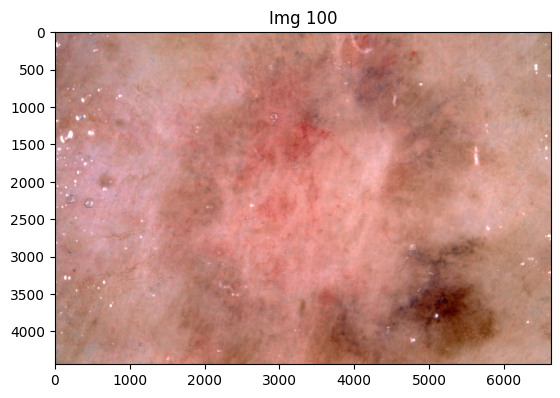

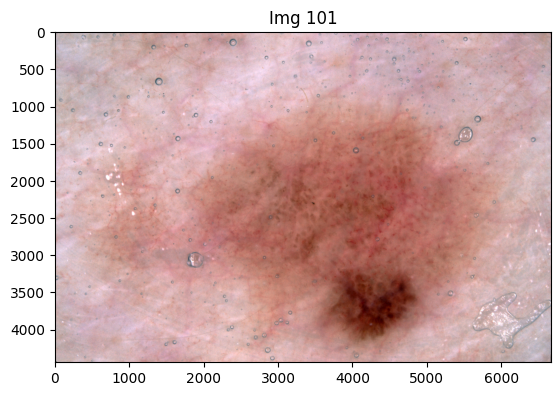

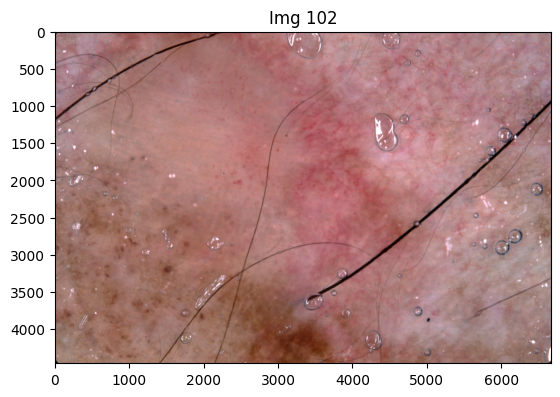

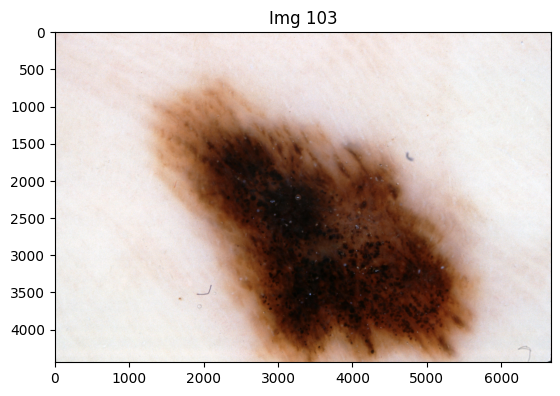

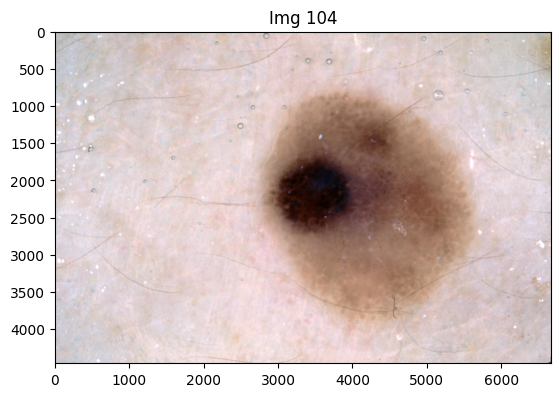

...

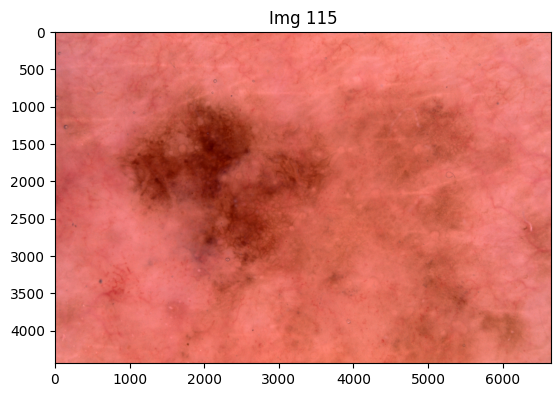

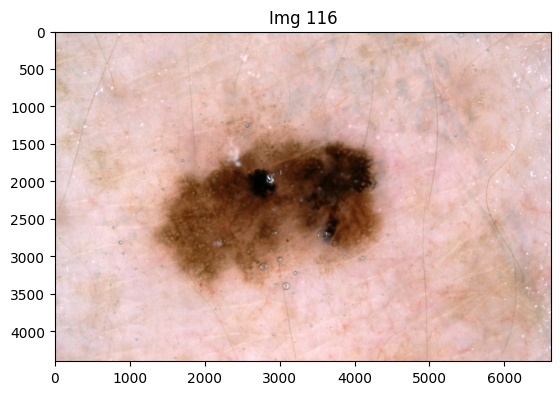

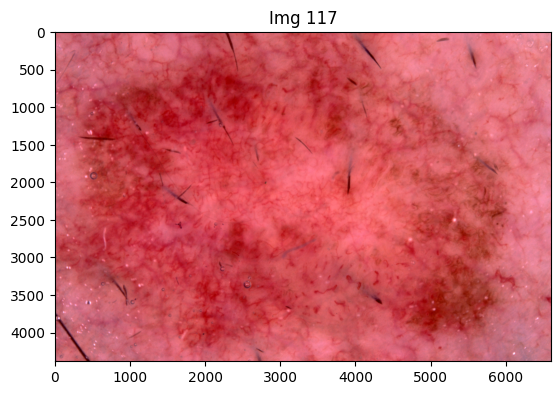

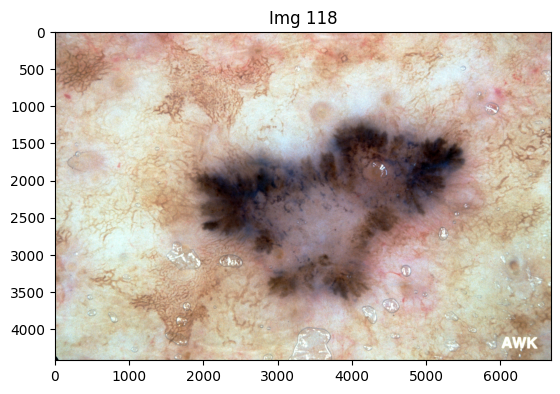

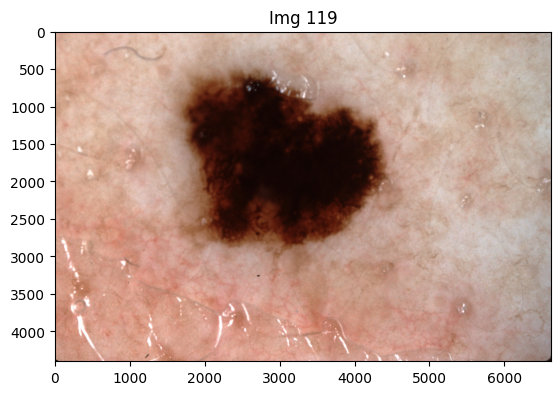

In [109]:
for i in range(100, 120): 
    class_name = malignant_no['benign_malignant'].iloc[i]
    old_path = filepath + malignant_no['image'].iloc[i]
    
    img = Image.open(old_path)
    plt.title(f"Img {i}")
    plt.imshow(img)
    plt.show()

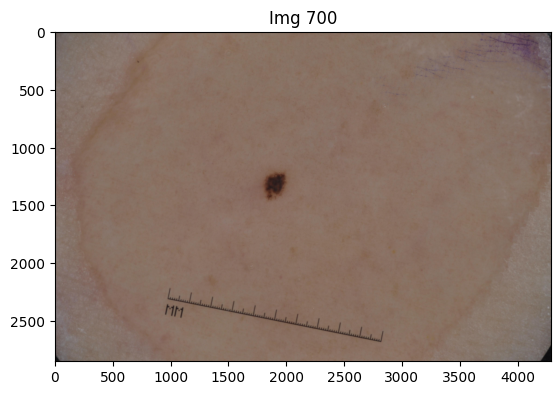

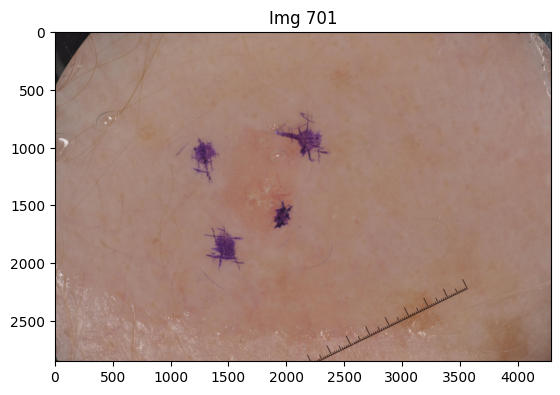

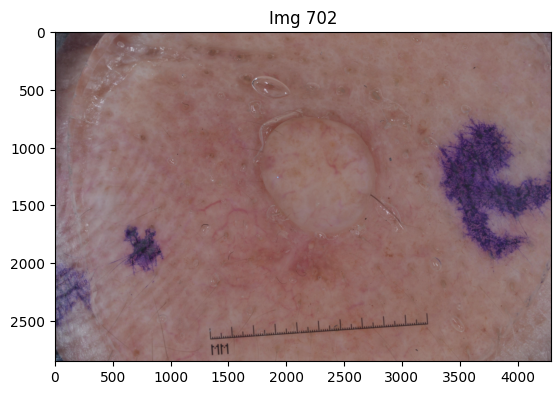

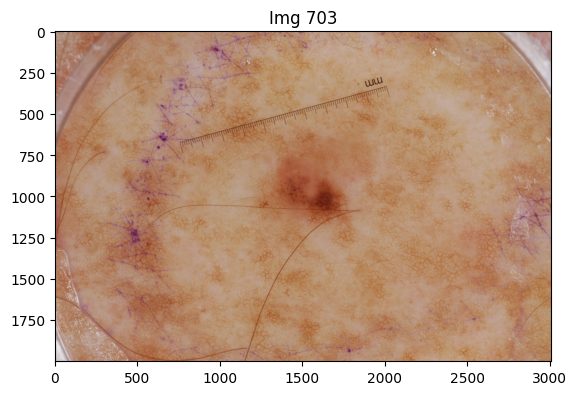

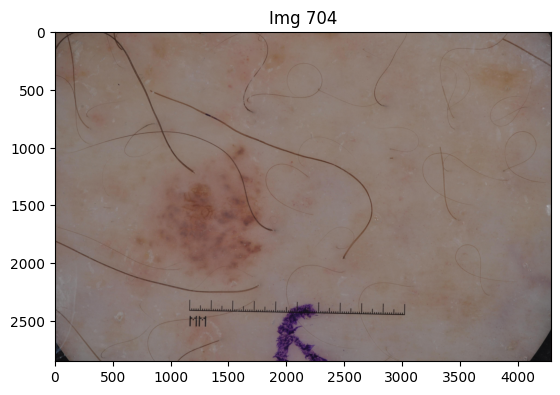

...

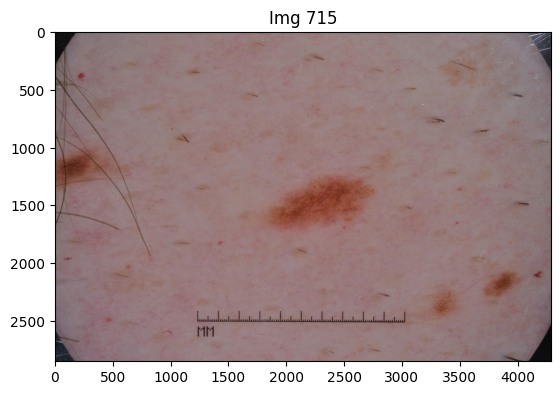

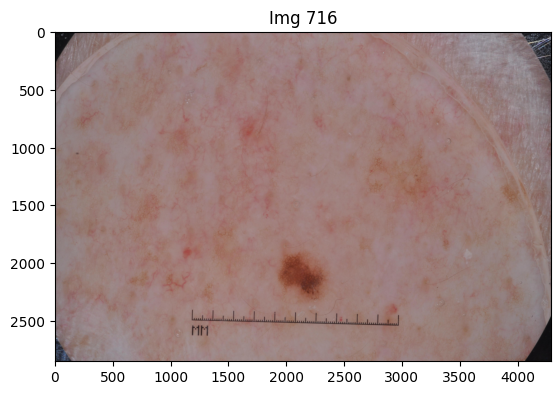

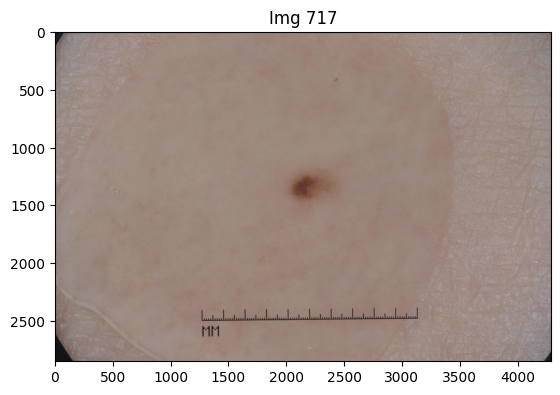

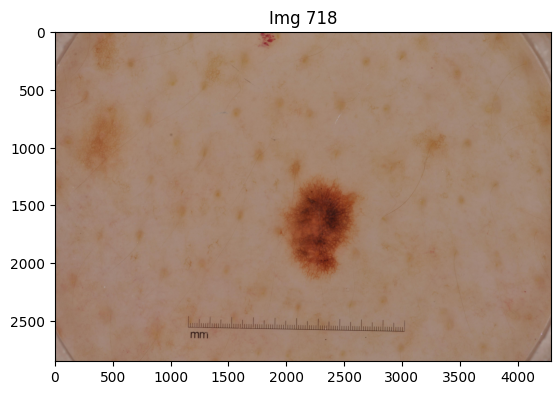

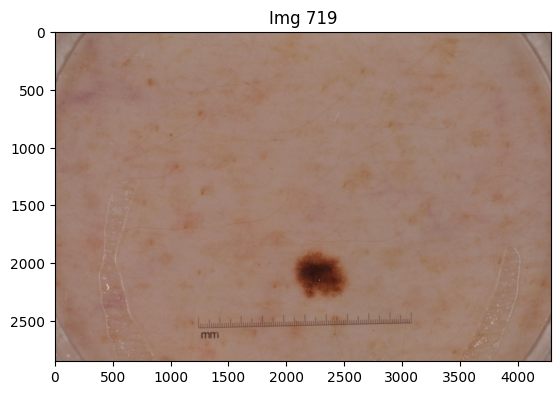

In [104]:
for i in range(700, 720): 
    class_name = benign_yes['benign_malignant'].iloc[i]
    old_path = filepath + benign_yes['image'].iloc[i]
    
    img = Image.open(old_path)
    plt.title(f"Img {i}")
    plt.imshow(img)
    plt.show()

# Dreambooth Inpainting

In [3]:
filepath = "/data/scratch/wgerych/spurious_ISIC_ruler_no_patches/"
prev_train_dataset = SpuriousDermDataset(file_path=filepath, split='train')
prev_train_dataset_mask = SpuriousDermDataset(file_path=filepath, split='train', get_mask=True)

prev_val_dataset = SpuriousDermDataset(file_path=filepath, split='val')
prev_val_dataset_mask = SpuriousDermDataset(file_path=filepath, split='val', get_mask=True)

add_indices = list(prev_val_dataset.metadata_for_split.sample(n=len(prev_val_dataset) - 50, random_state=0).index)

train_dataset = torch.utils.data.ConcatDataset([torch.utils.data.Subset(prev_val_dataset, add_indices),
                                                    prev_train_dataset])
train_dataset_mask = torch.utils.data.ConcatDataset([torch.utils.data.Subset(prev_val_dataset_mask, add_indices),
                                                    prev_train_dataset_mask])
print(len(train_dataset))
print(len(train_dataset_mask))

1039
1039


In [4]:
print(len(SpuriousDermDataset(file_path=filepath, split='val')))

219


In [17]:
from diffusers import StableDiffusionInpaintPipeline
from diffusers import UNet2DConditionModel

checkpoint = 2500
model_id = "runwayml/stable-diffusion-v1-5"
file_prefix = f"/mnt/scratch-lids/scratch/qixuanj/dreambooth/isic_sd_base_no_patches_checkpoint-2000/malignant-source/checkpoint-{checkpoint}"
unet = UNet2DConditionModel.from_pretrained(f"{file_prefix}/unet")
pipe = StableDiffusionInpaintPipeline.from_pretrained(model_id, unet=unet, dtype=torch.bfloat16, safety_checker=None,)
pipe.to("cuda")

Keyword arguments {'dtype': torch.bfloat16} are not expected by StableDiffusionInpaintPipeline and will be ignored.
Loading pipeline components...: 100%|███████████████████████████████████████████████████████████████████████████████████████████| 6/6 [00:00<00:00, 14.50it/s]
You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion_inpaint.StableDiffusionInpaintPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


StableDiffusionInpaintPipeline {
  "_class_name": "StableDiffusionInpaintPipeline",
  "_diffusers_version": "0.28.0.dev0",
  "_name_or_path": "runwayml/stable-diffusion-v1-5",
  "feature_extractor": [
    "transformers",
    "CLIPImageProcessor"
  ],
  "image_encoder": [
    null,
    null
  ],
  "requires_safety_checker": true,
  "safety_checker": [
    null,
    null
  ],
  "scheduler": [
    "diffusers",
    "PNDMScheduler"
  ],
  "text_encoder": [
    "transformers",
    "CLIPTextModel"
  ],
  "tokenizer": [
    "transformers",
    "CLIPTokenizer"
  ],
  "unet": [
    "diffusers",
    "UNet2DConditionModel"
  ],
  "vae": [
    "diffusers",
    "AutoencoderKL"
  ]
}

In [151]:
from diffusers import AutoPipelineForImage2Image

model_id = "runwayml/stable-diffusion-v1-5"
pipeline = AutoPipelineForImage2Image.from_pretrained(
    model_id, unet=unet, torch_dtype=torch.float32, safety_checker=None,
)
pipeline.to("cuda")

Loading pipeline components...: 100%|███████████████████████████████████████████████████████████████████████████████████████████| 6/6 [00:00<00:00, 10.05it/s]
You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion_img2img.StableDiffusionImg2ImgPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


StableDiffusionImg2ImgPipeline {
  "_class_name": "StableDiffusionImg2ImgPipeline",
  "_diffusers_version": "0.28.0.dev0",
  "_name_or_path": "runwayml/stable-diffusion-v1-5",
  "feature_extractor": [
    "transformers",
    "CLIPImageProcessor"
  ],
  "image_encoder": [
    null,
    null
  ],
  "requires_safety_checker": true,
  "safety_checker": [
    null,
    null
  ],
  "scheduler": [
    "diffusers",
    "PNDMScheduler"
  ],
  "text_encoder": [
    "transformers",
    "CLIPTextModel"
  ],
  "tokenizer": [
    "transformers",
    "CLIPTokenizer"
  ],
  "unet": [
    "diffusers",
    "UNet2DConditionModel"
  ],
  "vae": [
    "diffusers",
    "AutoencoderKL"
  ]
}

### Benign

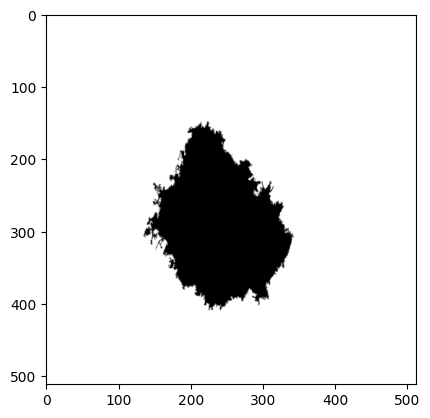

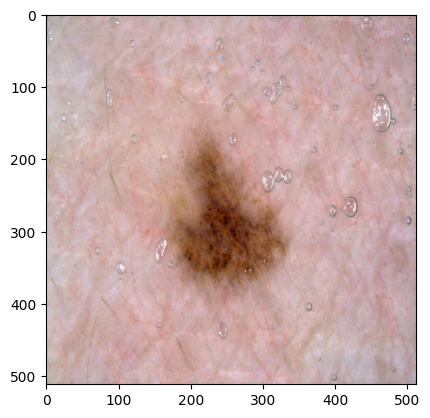

In [154]:
# benign ones
# 0, 3

i = 0
assert(train_dataset[i][1] == 0)
img = train_dataset[i][0]
mask = train_dataset_mask[i][0]
mask_mod = PIL.ImageOps.invert(mask).convert("L")
plt.imshow(mask_mod,cmap='gray')
plt.show()
plt.imshow(img)
plt.show()

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:22<00:00,  1.53it/s]


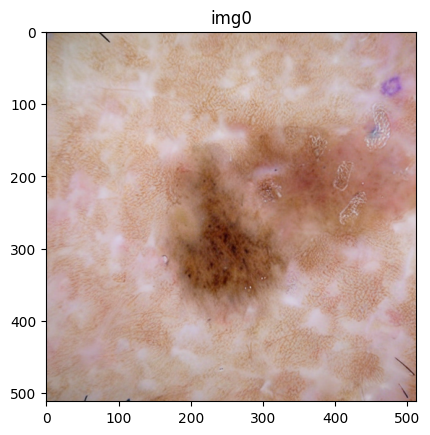

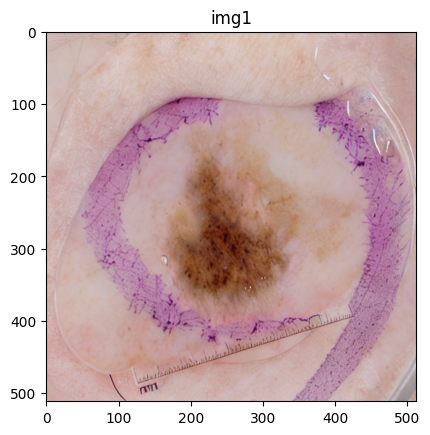

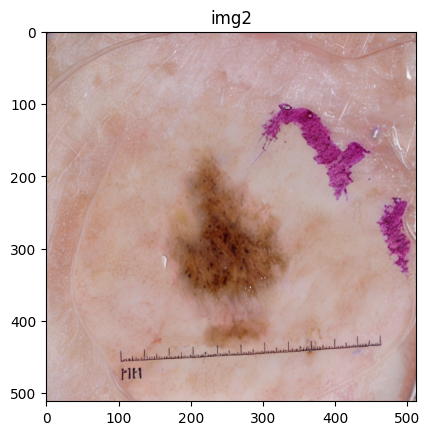

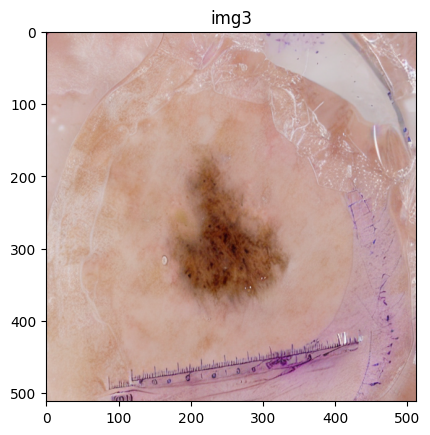

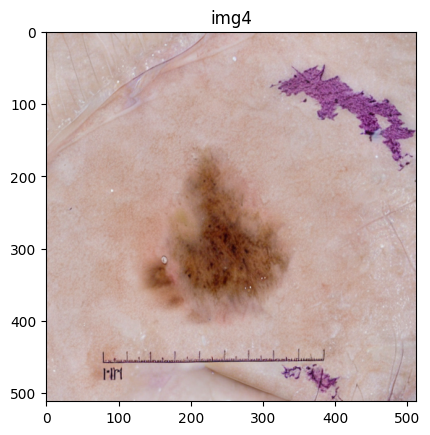

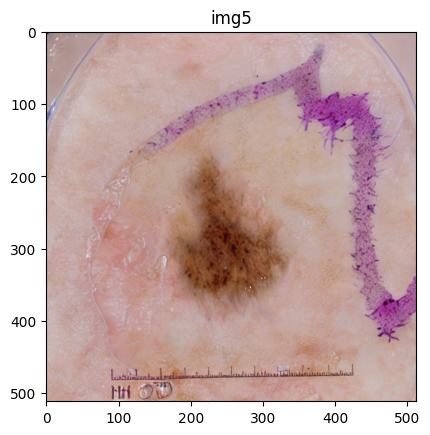

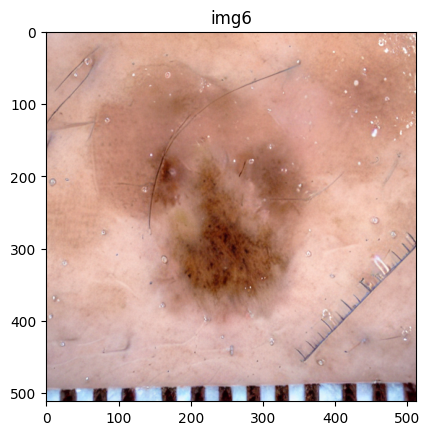

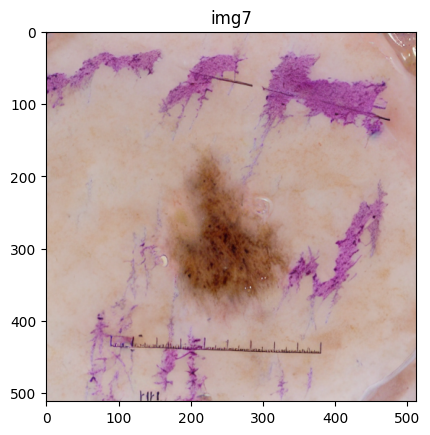

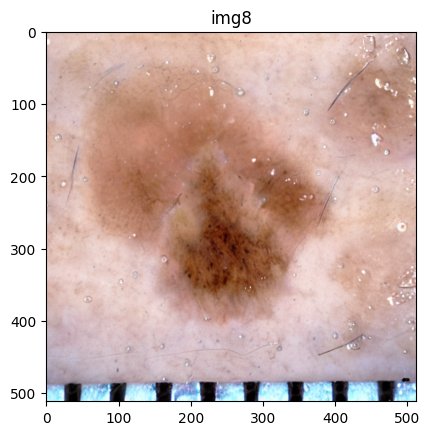

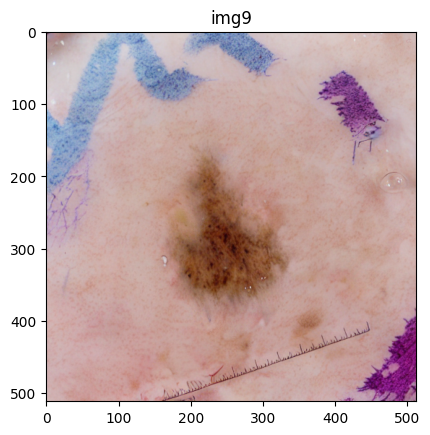

In [19]:
prompt = f"a dermoscopic image of malignant-source skin lesion"
image1 = pipe(prompt=prompt, 
             negative_prompt=''' pixelated, blurry, jpeg artifacts, low quality, 
                                 cartoon, artwork, cgi, illustration, painting, overexposed, 
                                 grayscale, grainy, multiple angles, ''',
             image=img, 
             mask_image=mask_mod, 
             strength=0.7,
             guidance_scale=15,
             num_inference_steps=50,
           num_images_per_prompt=10)
for j, image in enumerate(image1.images): 
    plt.title(f"img{j}")
    plt.imshow(image)
    plt.show()

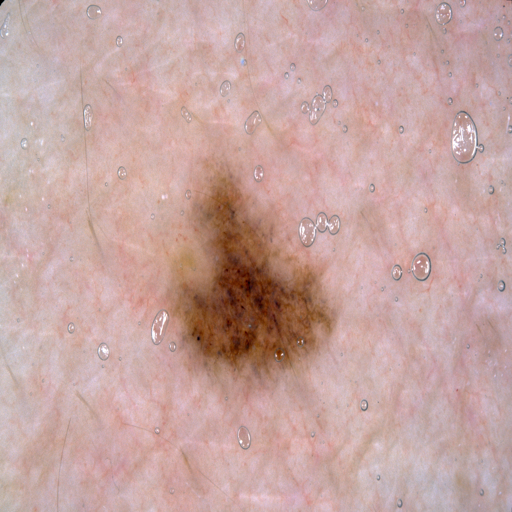

In [155]:
img

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:08<00:00,  2.88it/s]


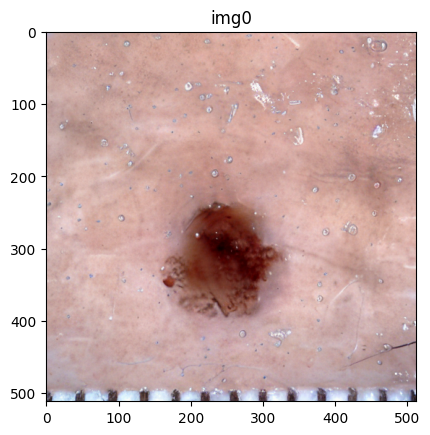

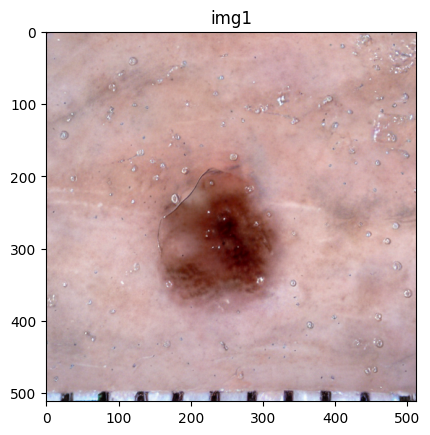

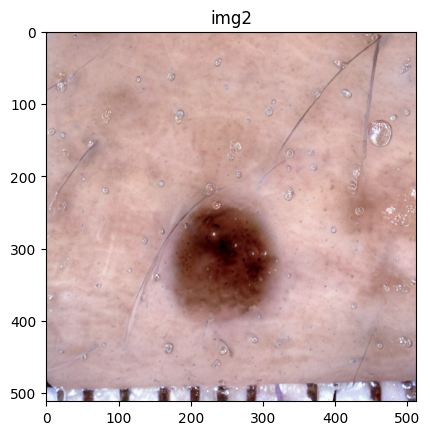

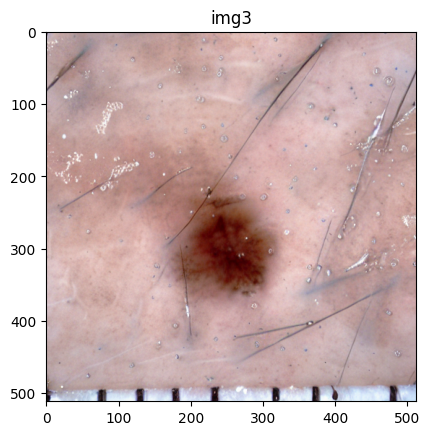

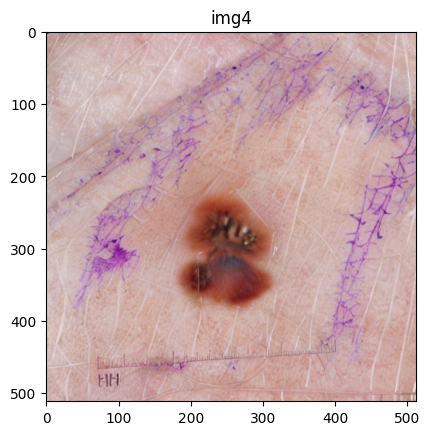

In [158]:
prompt = f"a dermoscopic image of benign-target skin lesion"
img_mod2 = pipeline(prompt=prompt, 
                    image = img,
                     negative_prompt=''' pixelated, blurry, jpeg artifacts, low quality, 
                                         cartoon, artwork, cgi, illustration, painting, overexposed, 
                                         grayscale, grainy, multiple angles, ''',
                     strength=0.5,
                     guidance_scale=15,
                     num_inference_steps=50, 
                     num_images_per_prompt=5)
for j, image in enumerate(img_mod2.images): 
    plt.title(f"img{j}")
    plt.imshow(image)
    plt.show()

In [776]:
background_images = glob("/mnt/scratch-lids/scratch/qixuanj/inversion_datasets/isic/target100background/*.jpg")

In [777]:
print(len(background_images))

50


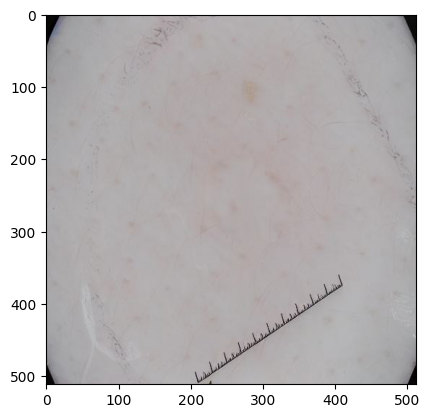

In [819]:
background_image = Image.open("/mnt/scratch-lids/scratch/qixuanj/inversion_datasets/isic/target100background/img82.jpg")
plt.imshow(background_image)

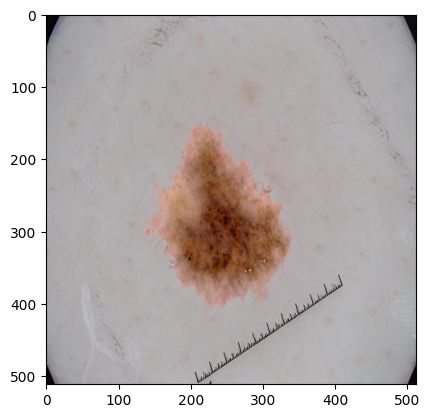

In [828]:
img_mod = PIL.Image.composite(img, background_image, mask)
plt.imshow(img_mod)

In [829]:
blurred_mask = pipe.mask_processor.blur(mask_mod, blur_factor=33)

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [00:08<00:00,  2.89it/s]


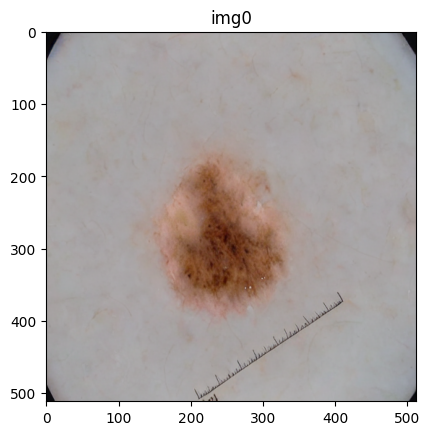

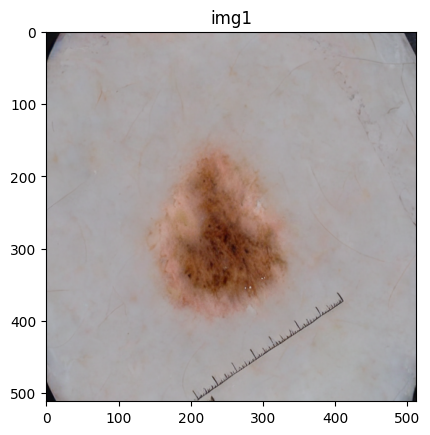

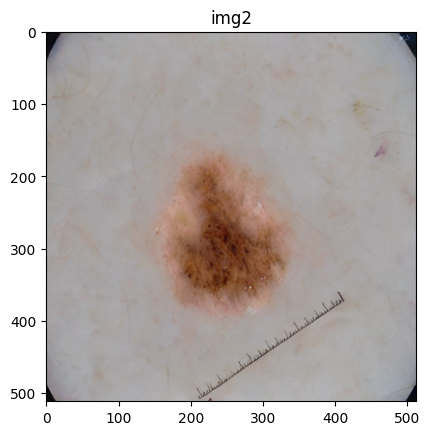

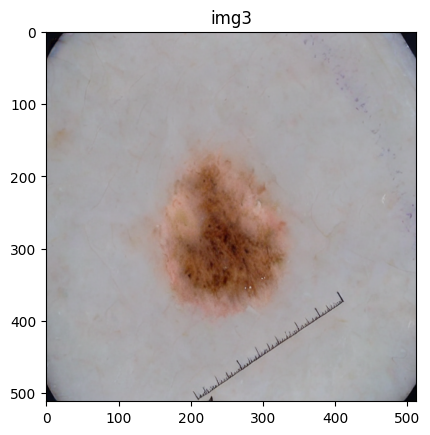

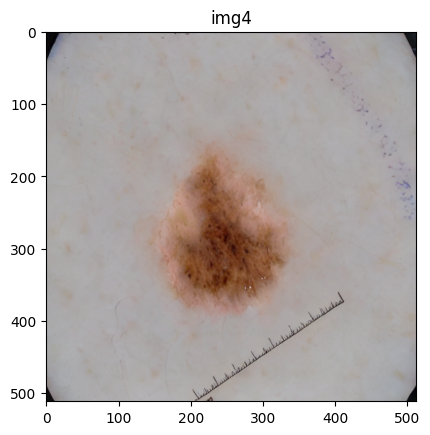

In [832]:
prompt = f"a dermoscopic image of benign-target skin lesion"
image1 = pipe(prompt=prompt, 
             negative_prompt=''' pixelated, blurry, jpeg artifacts, low quality, 
                                 cartoon, artwork, cgi, illustration, painting, overexposed, 
                                 grayscale, grainy, multiple angles, ''',
             image=img_mod, 
             mask_image=blurred_mask, 
             strength=0.5,
             guidance_scale=7.5,
             num_inference_steps=50,
           num_images_per_prompt=5)
for j, image in enumerate(image1.images): 
    plt.title(f"img{j}")
    plt.imshow(image)
    plt.show()

### Malignant

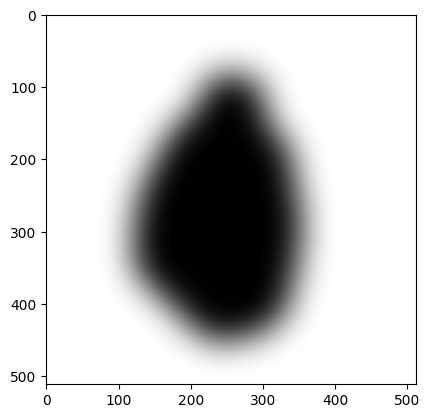

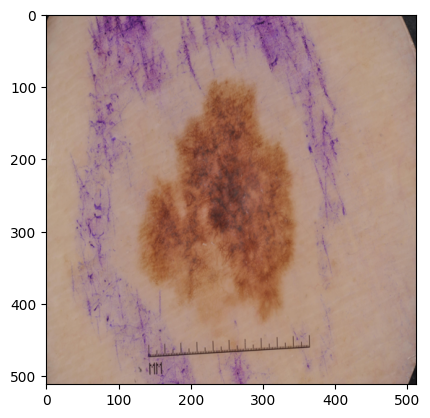

In [1012]:
# Malignant ones
# 1000 - 802-804, 806 works; 800-802 doesn't
# 1500 - 800 better, but smears things, unrealistic

i = 803
assert(train_dataset[i][1] == 1)
img = train_dataset[i][0]
mask_mod = PIL.ImageOps.invert(train_dataset_mask[i][0])
blurred_mask = pipe.mask_processor.blur(mask_mod, blur_factor=22)
plt.imshow(blurred_mask,cmap='gray')
plt.show()
plt.imshow(img)
plt.show()

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:23<00:00,  1.51it/s]


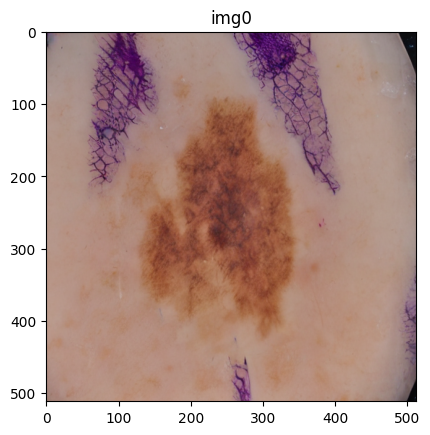

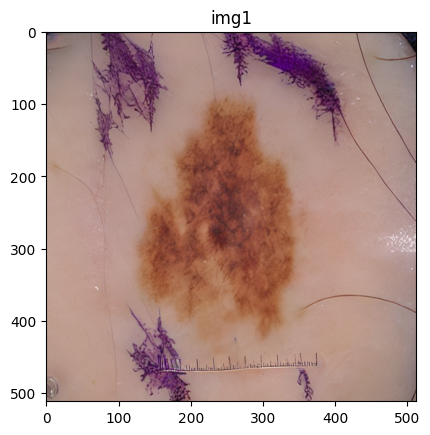

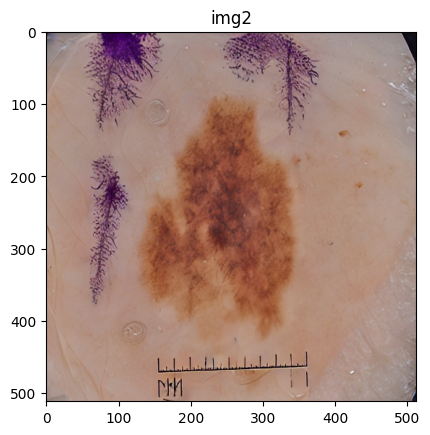

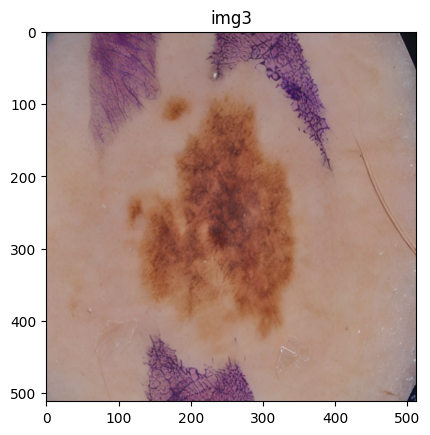

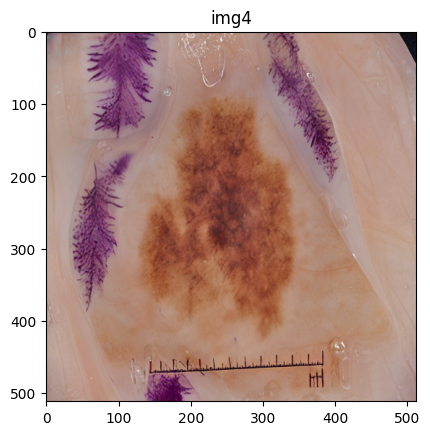

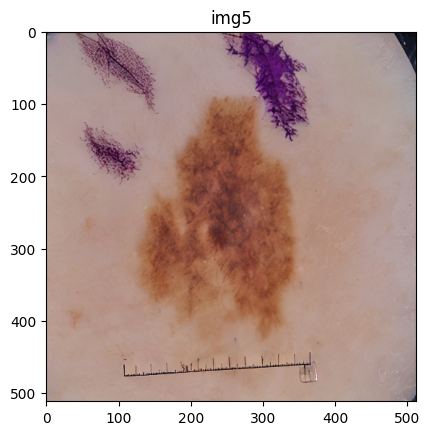

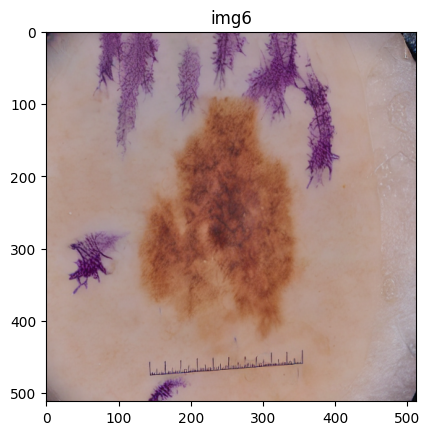

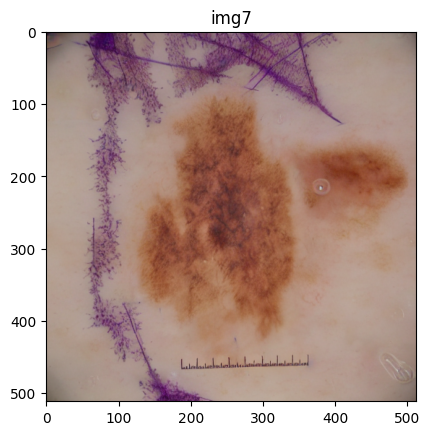

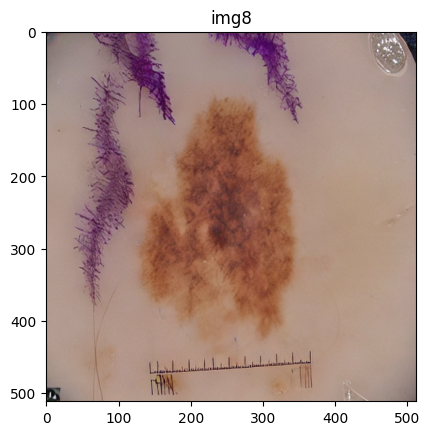

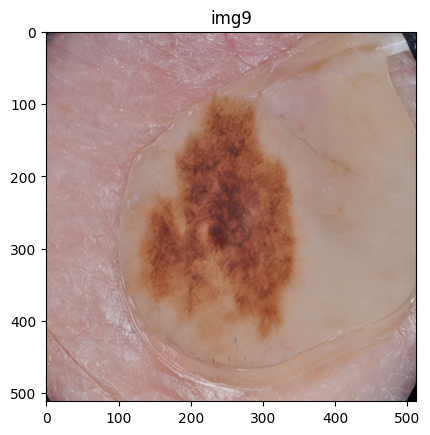

In [1013]:
prompt = f"a dermoscopic image of benign-source skin lesion"
image1 = pipe(prompt=prompt, 
             negative_prompt=''' pixelated, blurry, jpeg artifacts, low quality, 
                                 cartoon, artwork, cgi, illustration, painting, overexposed, 
                                 grayscale, grainy, multiple angles, ''',
             image=img, 
             mask_image=mask_mod, 
             strength=0.7,
             guidance_scale=20,
             num_inference_steps=50,
             num_images_per_prompt=10)
for j, image in enumerate(image1.images): 
    plt.title(f"img{j}")
    plt.imshow(image)
    plt.show()

## Visualize some of the generated images

In [845]:
data_dir = "/mnt/scratch-lids/scratch/qixuanj/isic_generated_images/isic_sd_base_no_patches_checkpoint-2000_target100background/strength0.7"
img_paths = sorted(glob(data_dir + "/*.png"))
print(len(img_paths))

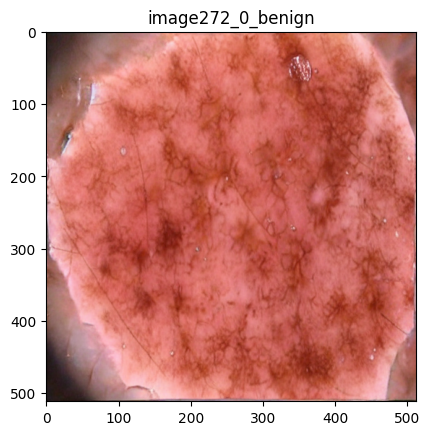

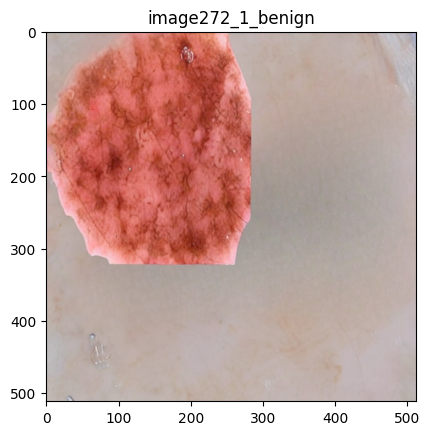

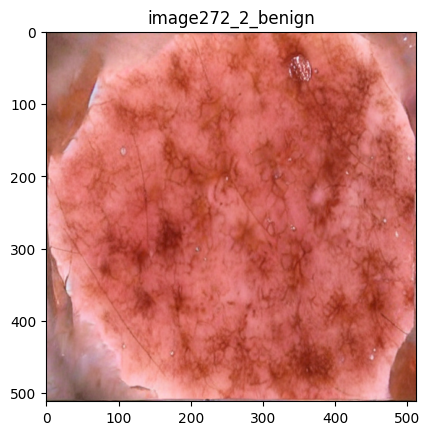

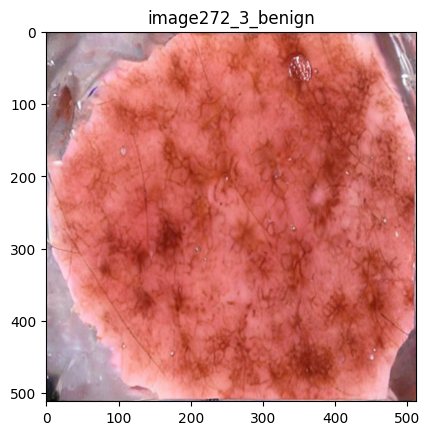

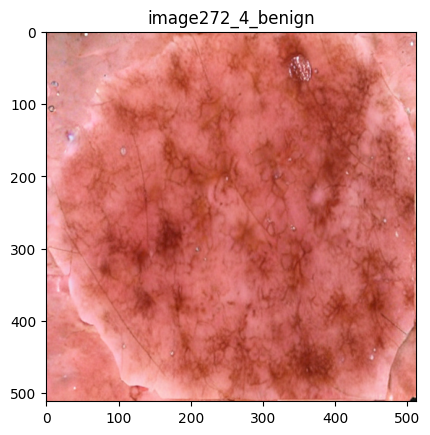

In [841]:
offset = 205

for k in range(offset, offset + 5): 
    img = Image.open(img_paths[k])
    title = img_paths[k].split("/")[-1].split(".")[0]
    plt.title(title)
    plt.imshow(img)
    plt.show()

# Load generated images

In [159]:
label_map = {
    1: "malignant", 
    0: "benign",
}

In [163]:
filepath = "/data/scratch/wgerych/spurious_ISIC_ruler_no_patches/"
gen_dir = "/mnt/scratch-lids/scratch/qixuanj/isic_generated_images/isic_sd_base_no_patches_checkpoint-2000_target100"

In [172]:
df_gen_metadata = pd.read_csv(gen_dir + "/metadata_gen.csv", index_col = 0)

In [50]:
# df_gen_metadata['gen_source'] = np.nan
# img_paths = sorted(glob(gen_dir + "/source/*.png"))
# for img_path in img_paths: 
#     index = int(img_path.split("/")[-1].split("_")[0].split("image")[-1])
#     class_name = img_path.split("/")[-1].split("_")[-1].split(".")[0]
#     assert(class_name == df_gen_metadata.loc[df_gen_metadata['index'] == index, 'benign_malignant'].values)
#     df_gen_metadata.loc[df_gen_metadata['index'] == index, 'gen_source'] = img_path 

In [173]:
df_gen_metadata['img2img_0.5'] = np.nan
img_paths = glob(gen_dir + "/img2img/strength0.5/*.png")
for img_path in img_paths: 
    index = int(img_path.split("/")[-1].split("_")[0].split("image")[-1])
    class_name = img_path.split("/")[-1].split("_")[2].split(".")[0]

    if class_name == "benign": 
        group = 2 
    elif class_name == "malignant": 
        group = 1
    df_gen_metadata.loc[df_gen_metadata['index'] == index, 'img2img_0.5'] = img_path 

In [174]:
df_gen_metadata

,index,text2img,benign_malignant,class,img2img_0.5
0,1030,/mnt/scratch-lids/scratch/qixuanj/isic_generat...,benign,2,/mnt/scratch-lids/scratch/qixuanj/isic_generat...
1,44,/mnt/scratch-lids/scratch/qixuanj/isic_generat...,benign,2,/mnt/scratch-lids/scratch/qixuanj/isic_generat...
2,674,/mnt/scratch-lids/scratch/qixuanj/isic_generat...,benign,2,/mnt/scratch-lids/scratch/qixuanj/isic_generat...
3,239,/mnt/scratch-lids/scratch/qixuanj/isic_generat...,malignant,1,/mnt/scratch-lids/scratch/qixuanj/isic_generat...
4,877,/mnt/scratch-lids/scratch/qixuanj/isic_generat...,malignant,1,/mnt/scratch-lids/scratch/qixuanj/isic_generat...
...,...,...,...,...,...
1034,323,/mnt/scratch-lids/scratch/qixuanj/isic_generat...,malignant,1,/mnt/scratch-lids/scratch/qixuanj/isic_generat...
1035,636,/mnt/scratch-lids/scratch/qixuanj/isic_generat...,benign,2,/mnt/scratch-lids/scratch/qixuanj/isic_generat...
1036,909,/mnt/scratch-lids/scratch/qixuanj/isic_generat...,benign,2,/mnt/scratch-lids/scratch/qixuanj/isic_generat...
1037,528,/mnt/scratch-lids/scratch/qixuanj/isic_generat...,benign,2,/mnt/scratch-lids/scratch/qixuanj/isic_generat...


In [798]:
# cols = ['index', 'text2img', 'benign_malignant', 'class']
# df_gen_metadata = pd.DataFrame(columns = cols)

# img_paths = glob(gen_dir + "/text2img/*.png")
# for img_path in img_paths: 
#     index = int(img_path.split("/")[-1].split("_")[0].split("image")[-1])
#     class_name = img_path.split("/")[-1].split("_")[2].split(".")[0]

#     if class_name == "benign": 
#         group = 2 
#     elif class_name == "malignant": 
#         group = 1
#     df_gen_metadata = pd.concat([df_gen_metadata, pd.DataFrame([[index, img_path, class_name, group]], 
#                                               columns=cols)], ignore_index=True)

In [901]:
# cols = ['index', 'strength0.5', 'strength0.7', 'benign_malignant', 'class']
# df_gen_metadata = pd.DataFrame(columns = cols)

# img_paths = sorted(glob(gen_dir + "/strength0.5/*.png"))
# for img_path in img_paths: 
#     index = int(img_path.split("/")[-1].split("_")[0].split("image")[-1])
#     class_name = img_path.split("/")[-1].split("_")[2].split(".")[0]
#     img_path2 = img_path.replace("0.5", "0.7")
#     # img_path3 = img_path.replace("0.5", "0.9")
#     assert(os.path.exists(img_path2))
#     # assert(os.path.exists(img_path3))
#     if class_name == "benign": 
#         group = 2 
#     elif class_name == "malignant": 
#         group = 1
#     df_gen_metadata = pd.concat([df_gen_metadata, pd.DataFrame([[index, img_path, 
#                                               img_path2, class_name, group]], 
#                                               columns=cols)], ignore_index=True)

In [902]:
df_gen_metadata['class'].value_counts()

class
2    4055
1    1140
Name: count, dtype: int64

In [175]:
df_gen_metadata.to_csv(gen_dir + "/metadata_gen.csv")

In [196]:
# Baseline txt2img or img2img_0.5 
# gen_dir = "/mnt/scratch-lids/scratch/qixuanj/isic_generated_images/isic_sd_base_no_patches_checkpoint-2000_target100/"
# gen_ds = SpuriousDermDataset(file_path = gen_dir, 
#                             gen_version="img2img_0.5")

# Class-conditional 
# gen_dir = "/mnt/scratch-lids/scratch/qixuanj/isic_generated_images/isic_sd_base_no_patches_checkpoint-2000/"
# gen_ds = SpuriousDermDataset(file_path = gen_dir, 
#                             gen_version="gen_source")

# Hard mask filter, 5 per train image
gen_dir = "/mnt/scratch-lids/scratch/qixuanj/isic_generated_images/isic_sd_base_no_patches_checkpoint-2000_target100background/"
gen_ds = SpuriousDermDataset(file_path = gen_dir, 
                             gen_version="strength0.5")
print(len(gen_ds))

5195


In [197]:
subset_indices = np.where(gen_ds.metadata_for_split['strength0.5'].str.contains('_0_'))[0]

In [198]:
subset_indices

array([   0,    5,   10, ..., 5180, 5185, 5190])

In [199]:
gen_ds = torch.utils.data.Subset(gen_ds, subset_indices)

In [200]:
print(len(gen_ds))

1039


In [201]:
gen_ds[0]

(<PIL.Image.Image image mode=RGB size=512x512>, 0, 2)

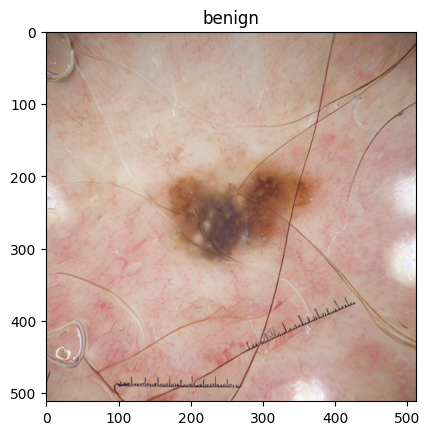

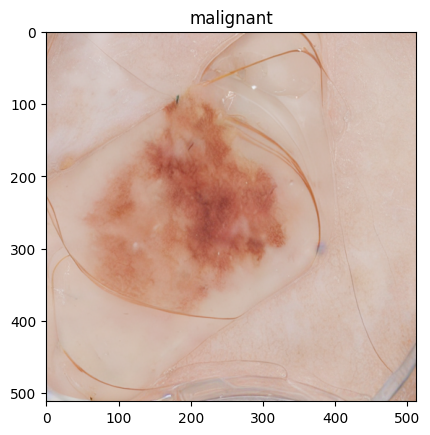

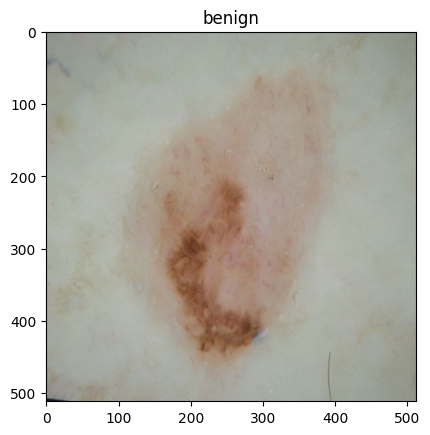

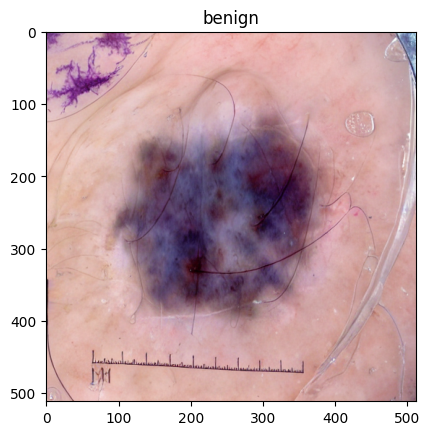

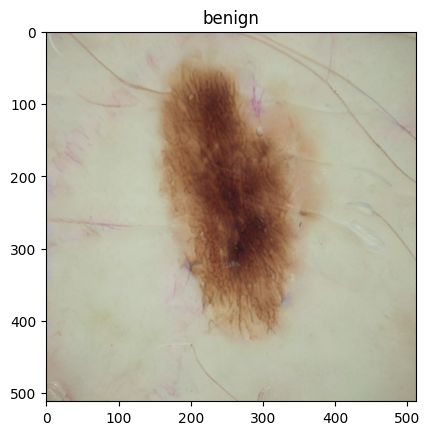

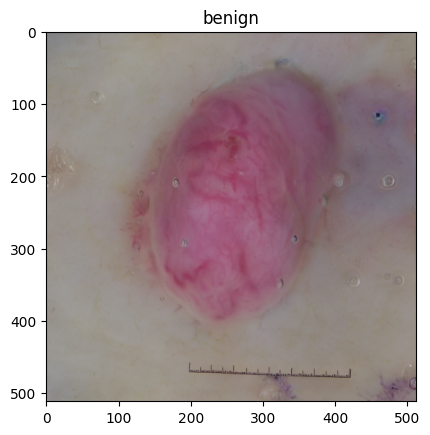

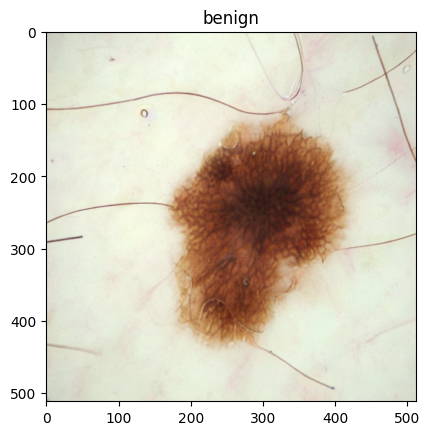

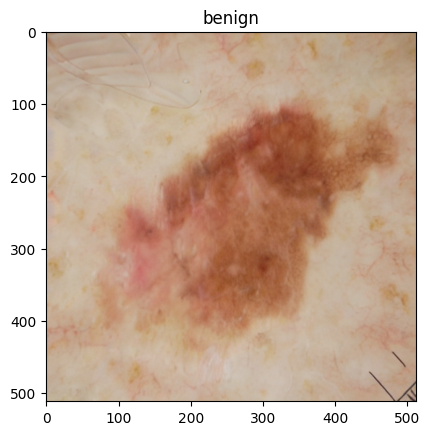

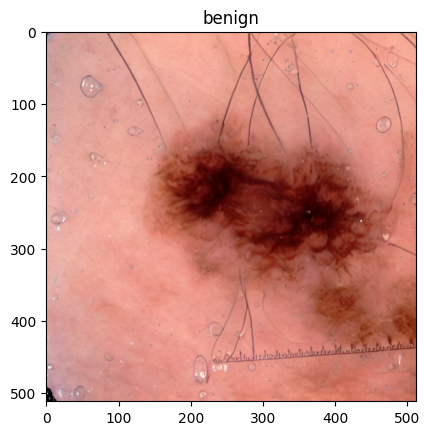

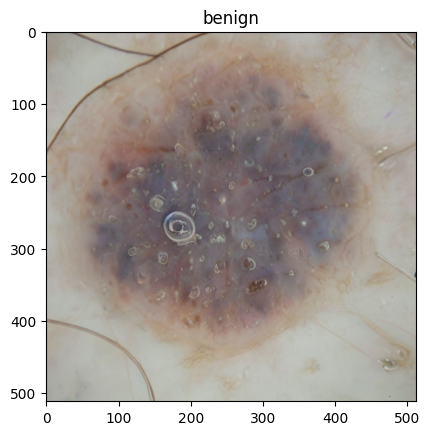

In [53]:
offset = 0
for i in range(offset, offset + 10): 
    img = gen_ds[i][0]
    class_name = label_map[gen_ds[i][1]]
    plt.title(class_name)
    plt.imshow(img)
    plt.show()

# Filter Badly Generated Images

## Confidence based filtering

In [37]:
transform = torchvision.transforms.Compose([# v2.CenterCrop(224),
                                            v2.Resize((224, 224)), 
                                            v2.RandomHorizontalFlip(),
                                            v2.ToImage(),
                                            v2.ToDtype(torch.float32, scale=True),
                                            v2.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]), 
                                            ])

In [38]:
filepath = "/data/scratch/wgerych/spurious_ISIC_ruler_no_patches/"
prev_train_dataset = SpuriousDermDataset(file_path=filepath, split='train', transform=transform)
prev_val_dataset = SpuriousDermDataset(file_path=filepath, split='val', transform=transform)
add_indices = list(prev_val_dataset.metadata_for_split.sample(n=len(prev_val_dataset) - 50, random_state=0).index)
train_ds = torch.utils.data.ConcatDataset([torch.utils.data.Subset(prev_val_dataset, add_indices), prev_train_dataset,])
print(len(train_dataset))

1039


In [138]:
strength = "0.7"

In [139]:
gen_dir = "/mnt/scratch-lids/scratch/qixuanj/isic_generated_images/isic_sd_base_no_patches_checkpoint-2000/"
gen_ds = SpuriousDermDataset(file_path = gen_dir, 
                            gen_version=f"gen_{strength}", 
                            transform=transform)
print(len(gen_ds))

1039


In [58]:
conf_model_path = "/mnt/scratch-lids/scratch/qixuanj/isic_results_densenet121_no_patches/base_seed0"
with open(f"{conf_model_path}/val_aucs.pkl", "rb") as f: 
    val_aucs = pickle.load(f)
val_aucs = [x.item() for x in val_aucs]

# Get best checkpoint by highest val AUC 
epochs_map = np.arange(10, 50 + 1, 10)
checkpoint = str(epochs_map[np.argmax(np.array(val_aucs))])
print(f"Best checkpoint is {checkpoint} with val AUC of {np.max(np.array(val_aucs))}")

conf_model = torch.load(f"{conf_model_path}/checkpoint{checkpoint}.pt")
conf_model.to("cuda")
conf_model.eval()

Best checkpoint is 40 with val AUC of 0.9920261876783616


DenseNet(
  (features): Sequential(
    (conv0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (norm0): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu0): ReLU(inplace=True)
    (pool0): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (denseblock1): _DenseBlock(
      (denselayer1): _DenseLayer(
        (norm1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu1): ReLU(inplace=True)
        (conv1): Conv2d(64, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (norm2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu2): ReLU(inplace=True)
        (conv2): Conv2d(128, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      )
      (denselayer2): _DenseLayer(
        (norm1): BatchNorm2d(96, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu

In [143]:
class_confs = {0: [], 1: []}
sigmoid = torch.nn.Sigmoid()

for sample in tqdm(train_ds): 
    img, y = sample[0], sample[1]
    img = img[None, :, :, :].to("cuda")
    
    outputs = conf_model(img)
    correct_output = sigmoid(outputs).detach().cpu().squeeze().item()
    class_confs[y].append(correct_output)

  2%|██▋                                                                                                                    | 23/1039 [00:12<08:57,  1.89it/s]


KeyboardInterrupt: 

In [ ]:
thresholds = np.zeros(2)
for class_idx, outputs in class_confs.items(): 
    if len(outputs) == 0: 
        continue
    thresholds[class_idx] = np.mean(np.array(outputs))

In [ ]:
print(thresholds)

In [ ]:
conf_img_exclude = {0: [], 1: []}
conf_img_exclude_corrupt = {0: [], 1: []}
sigmoid = torch.nn.Sigmoid()

for i, sample in tqdm(enumerate(gen_ds)): 
    img, y = sample[0], sample[1]
    img = img[None, :, :, :].to("cuda")

    outputs = conf_model(img)
    outputs = sigmoid(outputs).squeeze().detach().cpu().item()
 
    if outputs > thresholds[y]: 
        conf_img_exclude[y].append(i)
    if outputs > thresholds[1-y]: 
        conf_img_exclude_corrupt[y].append(i)

In [ ]:
all_exclude = []
for key, value in conf_img_exclude.items(): 
    print(key)
    print(len(value))
    all_exclude += value

In [ ]:
for key, value in conf_img_exclude_corrupt.items(): 
    print(key)
    print(len(value))
    all_exclude += value

In [ ]:
all_exclude = np.unique(np.array(all_exclude))
print(len(all_exclude))

In [ ]:
all_exclude_paths = []
for i in all_exclude: 
    all_exclude_paths.append(gen_ds.metadata_for_split[f'gen_{strength}'].iloc[i])
print(len(all_exclude_paths))

In [ ]:
metadata = gen_ds.metadata

In [ ]:
new_col = f'gen_{strength}_filter1'
metadata[new_col] = np.nan

In [ ]:
for i in tqdm(metadata.index): 
    img_path = metadata[f'gen_{strength}'].loc[i]
    if pd.isnull(img_path):
        continue
    if img_path not in all_exclude_paths: 
        metadata.loc[i, new_col] = img_path

In [85]:
metadata[new_col].count()

745

In [86]:
metadata.to_csv(gen_dir + "/metadata_gen.csv", index=False)

In [87]:
metadata.columns

Index(['Unnamed: 0', 'index', 'gen_0.5', 'gen_0.7', 'gen_0.9',
       'benign_malignant', 'class', 'gen_0.9_filter1', 'gen_0.7_filter1',
       'gen_0.5_filter1'],
      dtype='object')

## Image similarity based filtering

In [180]:
strength = "0.9"
gen_version = f"gen_{strength}_filter1"
gen_dir = "/mnt/scratch-lids/scratch/qixuanj/isic_generated_images/isic_sd_base_no_patches_checkpoint-2000/"
gen_ds = SpuriousDermDataset(file_path = gen_dir, 
                            gen_version=gen_version,)
print(len(gen_ds))

378


In [181]:
prev_extra_dataset = SpuriousDermDataset(file_path=filepath, split='extra')
class1 = list(prev_extra_dataset.metadata_for_split[prev_extra_dataset.metadata_for_split['class'] == 1].sample(n=10, random_state=0).index)
class2 = list(prev_extra_dataset.metadata_for_split[prev_extra_dataset.metadata_for_split['class'] == 2].sample(n=10, random_state=0).index)
extra_ds = torch.utils.data.Subset(prev_extra_dataset, class1 + class2)
print(len(extra_ds))

20


In [182]:
all_extra_hist = []
for j in range(len(extra_ds)): 
    img2 = extra_ds[j][0]
    hist_img2 = cv2.calcHist([np.array(img2)], [0, 1, 2], None, [256, 256, 256], [0, 256, 0, 256, 0, 256])
    hist_img2[0, 0, 0] = 0 
    hist_img2 = cv2.normalize(hist_img2, hist_img2, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX)

    all_extra_hist.append(hist_img2)
print(len(all_extra_hist))

20


In [183]:
all_metrics_mean = []
for i in tqdm(range(len(gen_ds))): 
    img1 = gen_ds[i][0]
    hist_img1 = cv2.calcHist([np.array(img1)], [0, 1, 2], None, [256, 256, 256], [0, 256, 0, 256, 0, 256])
    hist_img1[0, 0, 0] = 0 
    hist_img1 = cv2.normalize(hist_img1, hist_img1, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX)

    metrics = []
    for hist_img2 in all_extra_hist: 
        metrics.append(cv2.compareHist(hist_img1, hist_img2, cv2.HISTCMP_CORREL))
    metrics = np.array(metrics)
    all_metrics_mean.append(np.nanmean(metrics))

 17%|████████████████████                                                                                                    | 63/378 [00:22<01:54,  2.76it/s]/tmp/ipykernel_736934/4090124188.py:12: RuntimeWarning: Mean of empty slice
  all_metrics_mean.append(np.nanmean(metrics))
100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 378/378 [02:16<00:00,  2.78it/s]


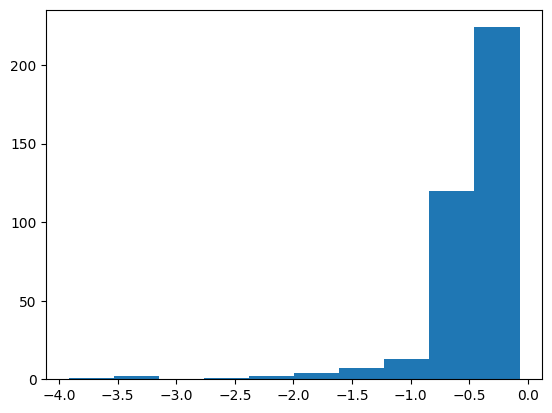

In [184]:
plt.hist(all_metrics_mean, bins=10)
plt.show()

In [185]:
all_metrics_mean = np.array(all_metrics_mean)

In [186]:
print(len(all_metrics_mean[all_metrics_mean < np.nanmean(all_metrics_mean)]))

114


In [187]:
all_exclude = np.where(all_metrics_mean < np.nanmean(all_metrics_mean))[0]

In [188]:
all_exclude_paths = []
for i in all_exclude: 
    all_exclude_paths.append(gen_ds.metadata_for_split[f'gen_{strength}_filter1'].iloc[i])

In [189]:
print(len(all_exclude_paths))

114


In [190]:
metadata = gen_ds.metadata

In [191]:
new_col = f'gen_{strength}_filter2'
metadata[new_col] = np.nan

In [192]:
for i in tqdm(metadata.index): 
    img_path = metadata[f'gen_{strength}_filter1'].loc[i]
    if pd.isnull(img_path):
        continue
    if img_path not in all_exclude_paths: 
        metadata.loc[i, new_col] = img_path

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1039/1039 [00:00<00:00, 33277.45it/s]


In [193]:
print(metadata[new_col].count())

264


In [194]:
metadata.to_csv(gen_dir + "/metadata_gen.csv", index=False)

In [196]:
metadata.columns

Index(['Unnamed: 0', 'index', 'gen_0.5', 'gen_0.7', 'gen_0.9',
       'benign_malignant', 'class', 'gen_0.9_filter1', 'gen_0.7_filter1',
       'gen_0.5_filter1', 'gen_0.5_filter2', 'gen_0.7_filter2',
       'gen_0.9_filter2'],
      dtype='object')

# Debug ISIC evaluation

In [861]:
from torcheval.metrics import BinaryAUROC

In [859]:
transform = torchvision.transforms.Compose([# v2.CenterCrop(224),
                                            v2.Resize((224, 224)), 
                                            v2.RandomHorizontalFlip(),
                                            v2.ToImage(),
                                            v2.ToDtype(torch.float32, scale=True),
                                            v2.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]), 
                                            ])
filepath = "/data/scratch/wgerych/spurious_ISIC_ruler_no_patches/"
test_dataset = SpuriousDermDataset(file_path=filepath, split='test', transform=transform)
test_dataloader = torch.utils.data.DataLoader(test_dataset, batch_size=8, shuffle=False)

In [883]:
test_aucs = []
# model_dir = "/mnt/scratch-lids/scratch/qixuanj/isic_results_densenet121_no_patches/oracle_seed0"
model_dir = "/mnt/scratch-lids/scratch/qixuanj/isic_results_resnet50_no_patches/oracle_seed0"
epochs_map = np.arange(10, 51, 10)
for epoch in epochs_map: 
    model = torch.load(f"{model_dir}/checkpoint{epoch}.pt")
    model.eval()
    t = tqdm(test_dataloader)
    
    test_task_outputs=[]
    test_task_targets=[]
    with torch.no_grad():
        for batch_idx, sample in enumerate(t):
            images, targets = sample[0], sample[1]
            images = images.to("cuda")
            targets = targets.to("cuda")
            outputs = model(images)
            sigmoid = torch.nn.Sigmoid()
            outputs = sigmoid(outputs)
            outputs = outputs.squeeze(1)
            targets = targets.to(torch.float32)
            test_task_outputs.append(outputs.detach().cpu().numpy())
            test_task_targets.append(targets.detach().cpu().numpy())
    test_task_outputs = np.concatenate(test_task_outputs)
    test_task_targets = np.concatenate(test_task_targets)
    
    auc = BinaryAUROC()
    auc.update(torch.Tensor(test_task_outputs), torch.Tensor(test_task_targets))
    test_auc_result = auc.compute()
    test_aucs.append(test_auc_result)
    print("Checkpoint {} Test AUC of {}".format(epoch, test_auc_result))

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:39<00:00,  1.13s/it]


Checkpoint 10 Test AUC of 0.7447959183673469


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:38<00:00,  1.09s/it]


Checkpoint 20 Test AUC of 0.707295918367347


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:39<00:00,  1.12s/it]


Checkpoint 30 Test AUC of 0.7438775510204082


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:38<00:00,  1.10s/it]


Checkpoint 40 Test AUC of 0.7653571428571428


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 35/35 [00:40<00:00,  1.15s/it]

Checkpoint 50 Test AUC of 0.7794897959183673


In [884]:
for x in [x.item() for x in test_aucs]: 
    print(round(x, 3))

0.745
0.707
0.744
0.765
0.779


In [885]:
prev_train_dataset = SpuriousDermDataset(file_path=filepath, split='train', transform=transform)
prev_val_dataset = SpuriousDermDataset(file_path=filepath, split='val', transform=transform)

add_indices = list(prev_val_dataset.metadata_for_split.sample(n=len(prev_val_dataset) - 50, random_state=0).index)
val_indices = list(set(prev_val_dataset.metadata_for_split.index) - set(add_indices))
val_dataset = torch.utils.data.Subset(prev_val_dataset, val_indices) 
val_dataloader = torch.utils.data.DataLoader(val_dataset, batch_size=8, shuffle=False)

In [886]:
val_aucs = []
model_dir = "/mnt/scratch-lids/scratch/qixuanj/isic_results_densenet121_no_patches/oracle_seed1"
epochs_map = np.arange(10, 51, 10)
for epoch in epochs_map:
    model = torch.load(f"{model_dir}/checkpoint{epoch}.pt")
    model.eval()
    
    t = tqdm(val_dataloader)
    val_task_outputs=[]
    val_task_targets=[]
    with torch.no_grad():
        for batch_idx, sample in enumerate(t):
            images, targets = sample[0], sample[1]
            images = images.to("cuda")
            targets = targets.to("cuda")
            outputs = model(images)
            sigmoid = torch.nn.Sigmoid()
            outputs = sigmoid(outputs)
            outputs = outputs.squeeze(1)
            targets = targets.to(torch.float32)
            val_task_outputs.append(outputs.detach().cpu().numpy())
            val_task_targets.append(targets.detach().cpu().numpy())
    val_task_outputs = np.concatenate(val_task_outputs)
    val_task_targets = np.concatenate(val_task_targets)
    auc = BinaryAUROC()
    auc.update(torch.Tensor(val_task_outputs), torch.Tensor(val_task_targets))
    val_auc_result = auc.compute()
    val_aucs.append(val_auc_result)
    print("Checkpoint {} Val AUC of {}".format(epoch, val_auc_result))

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:16<00:00,  2.34s/it]


Checkpoint 10 Val AUC of 0.6125


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:15<00:00,  2.25s/it]


Checkpoint 20 Val AUC of 0.5625


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:17<00:00,  2.46s/it]


Checkpoint 30 Val AUC of 0.49


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:16<00:00,  2.32s/it]


Checkpoint 40 Val AUC of 0.5725


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:18<00:00,  2.70s/it]

Checkpoint 50 Val AUC of 0.745


In [889]:
for x in [x.item() for x in val_aucs]: 
    print(round(x, 3))

0.613
0.562
0.49
0.573
0.745


In [890]:
with open(f"{model_dir}/val_aucs.pkl", "wb") as f: 
    pickle.dump(val_aucs, f) 
with open(f"{model_dir}/test_aucs.pkl", "wb") as f: 
    pickle.dump(test_aucs, f)

# Train Ruler Oracle

In [99]:
from torcheval.metrics import MulticlassAUROC, MulticlassAccuracy, BinaryAUROC, BinaryAccuracy

In [59]:
transform = torchvision.transforms.Compose([# v2.CenterCrop(224),
                                            v2.Resize((224, 224)), 
                                            v2.RandomHorizontalFlip(),
                                            v2.ToImage(),
                                            v2.ToDtype(torch.float32, scale=True),
                                            v2.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]), 
                                            ])

In [102]:
filepath = "/data/scratch/wgerych/spurious_ISIC_ruler_no_patches/"
prev_train_dataset = SpuriousDermDataset(file_path=filepath, split='train', transform=transform)
prev_extra_dataset = SpuriousDermDataset(file_path=filepath, split='extra', transform=transform)
test_dataset = SpuriousDermDataset(file_path=filepath, split='test', transform=transform)

In [61]:
oracle_dataset = torch.utils.data.ConcatDataset([prev_train_dataset, prev_extra_dataset])

In [103]:
train_dataloader = torch.utils.data.DataLoader(oracle_dataset, batch_size=64, shuffle=True)
test_dataloader = torch.utils.data.DataLoader(test_dataset, batch_size=8, shuffle=False)

In [65]:
label_map = {
    0: 'malignant_ruler', 
    1: 'malignant_no_ruler', 
    2: 'benign_ruler', 
    3: 'benign_no_ruler',
}

In [92]:
rulers_map = {
    0: 1, 
    1: 0, 
    2: 1, 
    3: 0,
}

In [88]:
model = torchvision.models.densenet121(weights='DenseNet121_Weights.IMAGENET1K_V1')
model.classifier = torch.nn.Linear(1024, 1)
model.to("cuda")

DenseNet(
  (features): Sequential(
    (conv0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (norm0): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu0): ReLU(inplace=True)
    (pool0): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (denseblock1): _DenseBlock(
      (denselayer1): _DenseLayer(
        (norm1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu1): ReLU(inplace=True)
        (conv1): Conv2d(64, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (norm2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu2): ReLU(inplace=True)
        (conv2): Conv2d(128, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      )
      (denselayer2): _DenseLayer(
        (norm1): BatchNorm2d(96, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu

In [89]:
optimizer = torch.optim.Adam(model.parameters(), lr=1e-3, weight_decay=1e-4)
# criterion = torch.nn.CrossEntropyLoss()
criterion = torch.nn.BCELoss()

In [77]:
output_dir = "/mnt/scratch-lids/scratch/qixuanj/isic_results_resnet50_no_patches/domain_seed0"

In [90]:
groups = groups.detach().cpu().numpy()

In [93]:
np.vectorize(rulers_map.get)(groups)

array([1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0,
       1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1,
       0])

In [100]:
epochs = 2
checkpoint_epochs = 1

train_aucs = [] 
test_aucs = []

avg_loss = []
for epoch in range(epochs):
    model.train()
    task_outputs=[]
    task_targets=[]
    
    t = tqdm(train_dataloader)
    for batch_idx, sample in enumerate(t): 
        optimizer.zero_grad()
        images, groups = sample[0], sample[2]
        rulers = np.vectorize(rulers_map.get)(groups)
        rulers = torch.Tensor(rulers).to("cuda")
        images = images.to("cuda")
        outputs = model(images)
        sigmoid = torch.nn.Sigmoid()
        outputs = sigmoid(outputs)
        outputs = outputs.squeeze(1)
        
        rulers = rulers.to(torch.float32)
        loss = criterion(outputs, rulers)
        loss.backward()
        optimizer.step()
        avg_loss.append(loss.detach().cpu().numpy())
        task_outputs.append(outputs.detach().cpu().numpy())
        task_targets.append(rulers.detach().cpu().numpy())
        t.set_description(f'Epoch {epoch + 1} - Loss = {np.mean(avg_loss):4.4f}')
        
    task_outputs = np.concatenate(task_outputs)
    task_targets = np.concatenate(task_targets)
    auc = BinaryAUROC()
    auc.update(torch.Tensor(task_outputs), torch.Tensor(task_targets))
    auc_result = auc.compute()
    train_aucs.append(auc_result)
    
    if (epoch + 1) % checkpoint_epochs == 0: 
        print("checkpoint!")
        model.eval()
        t = tqdm(test_dataloader)
        test_task_outputs=[]
        test_task_targets=[]
        with torch.no_grad():
            for batch_idx, sample in enumerate(t):
                images, groups = sample[0], sample[2]
                rulers = np.vectorize(rulers_map.get)(groups)
                rulers = torch.Tensor(rulers).to("cuda")
                images = images.to("cuda")

                outputs = model(images)
                sigmoid = torch.nn.Sigmoid()
                outputs = sigmoid(outputs)
                outputs = outputs.squeeze(1)
                rulers = rulers.to(torch.torch.float32)
                
                test_task_outputs.append(outputs.detach().cpu().numpy())
                test_task_targets.append(rulers.detach().cpu().numpy())
        test_task_outputs = np.concatenate(test_task_outputs)
        test_task_targets = np.concatenate(test_task_targets)
        auc = BinaryAUROC()
        auc.update(torch.Tensor(test_task_outputs), torch.Tensor(test_task_targets))
        test_auc_result = auc.compute()
        test_aucs.append(test_auc_result)
        print(f'Test Epoch {epoch + 1} - Avg AUC = {test_auc_result:4.4f}')
        torch.save(model, f"{output_dir}/checkpoint{epoch + 1}.pt")
    print(f'Train Epoch {epoch + 1} - Avg AUC = {auc_result:4.4f}')

Epoch 1 - Loss = 0.1651: 100%|████████████████████████████████████████████████████████████████████████████████████████████████| 30/30 [03:42<00:00,  7.42s/it]

checkpoint!


NameError: name 'test_dataloader' is not defined

In [105]:
prev_train_dataset.metadata_for_split

,isic_id,image,class,benign_malignant,mask,sex,age_approx,pixels_x,pixels_y
0,ISIC_0000000,train/ISIC_0000000.JPG,3,benign,train_mask/ISIC_0000000_segmentation.png,female,55.0,1022,767
1,ISIC_0000001,train/ISIC_0000001.JPG,3,benign,train_mask/ISIC_0000001_segmentation.png,female,30.0,1022,767
2,ISIC_0000003,train/ISIC_0000003.JPG,3,benign,train_mask/ISIC_0000003_segmentation.png,male,30.0,1022,767
3,ISIC_0000004,train/ISIC_0000004.JPG,0,malignant,train_mask/ISIC_0000004_segmentation.png,male,80.0,1022,767
4,ISIC_0000006,train/ISIC_0000006.JPG,3,benign,train_mask/ISIC_0000006_segmentation.png,female,25.0,1022,767
...,...,...,...,...,...,...,...,...,...
865,ISIC_0014927,train/ISIC_0014927.JPG,3,benign,train_mask/ISIC_0014927_segmentation.png,male,25.0,6668,4439
866,ISIC_0014929,train/ISIC_0014929.JPG,3,benign,train_mask/ISIC_0014929_segmentation.png,male,30.0,6708,4439
867,ISIC_0014930,train/ISIC_0014930.JPG,3,benign,train_mask/ISIC_0014930_segmentation.png,male,30.0,6728,4459
868,ISIC_0014933,train/ISIC_0014933.JPG,3,benign,train_mask/ISIC_0014933_segmentation.png,female,30.0,6688,4399


In [66]:
prev_train_dataset.metadata_for_split['class'].value_counts()

class
3    680
0    190
Name: count, dtype: int64

In [67]:
prev_extra_dataset.metadata_for_split['class'].value_counts()

class
2    892
1    139
Name: count, dtype: int64

In [117]:
# Use ruler oracle to evaluate generated images 
model = torch.load("/mnt/scratch-lids/scratch/qixuanj/isic_results_resnet50_no_patches/domain_seed0/checkpoint10.pt")
model.to("cuda")
model.eval()

DenseNet(
  (features): Sequential(
    (conv0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (norm0): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu0): ReLU(inplace=True)
    (pool0): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (denseblock1): _DenseBlock(
      (denselayer1): _DenseLayer(
        (norm1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu1): ReLU(inplace=True)
        (conv1): Conv2d(64, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (norm2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu2): ReLU(inplace=True)
        (conv2): Conv2d(128, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      )
      (denselayer2): _DenseLayer(
        (norm1): BatchNorm2d(96, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu

In [121]:
rulers_map = {
    0: 1, 
    1: 0, 
    2: 1, 
    3: 0,
}

In [118]:
gen_ds = SpuriousDermDataset(file_path="/mnt/scratch-lids/scratch/qixuanj/isic_generated_images/isic_sd_base_no_patches_checkpoint-2000_target100background/", 
                            gen_version="strength0.5",
                            transform=transform)

In [139]:
benign_ds = torch.utils.data.Subset(gen_ds, np.where(gen_ds.metadata_for_split['benign_malignant'] == 'benign')[0])
print(len(benign_ds))

4055


In [140]:
malignant_ds = torch.utils.data.Subset(gen_ds, np.where(gen_ds.metadata_for_split['benign_malignant'] == 'malignant')[0])
print(len(malignant_ds))

1140


In [119]:
print(len(gen_ds))

5195


In [145]:
gen_dataloader = torch.utils.data.DataLoader(malignant_ds, batch_size=64, shuffle=True)

In [146]:
counts = {
    0: 0, 
    1: 0,  
}

t = tqdm(gen_dataloader)
    
test_task_outputs=[]
test_task_targets=[]
with torch.no_grad():
    for batch_idx, sample in enumerate(t):
        images, groups = sample[0], sample[2]
        images = images.to("cuda")
        rulers = np.vectorize(rulers_map.get)(groups)
        rulers = torch.Tensor(rulers).to("cuda")
        
        outputs = model(images)
        sigmoid = torch.nn.Sigmoid()
        outputs = sigmoid(outputs)
        outputs = outputs.squeeze(1)
        rulers = rulers.to(torch.float32)
        
        predicted_class = (outputs > 0.5).float().detach().cpu().numpy()
        for j in predicted_class: 
            counts[j] += 1
        
        test_task_outputs.append(outputs.detach().cpu().numpy())
        test_task_targets.append(rulers.detach().cpu().numpy())
test_task_outputs = np.concatenate(test_task_outputs)
test_task_targets = np.concatenate(test_task_targets)

auc = BinaryAUROC()
auc.update(torch.Tensor(test_task_outputs), torch.Tensor(test_task_targets))
test_auc_result = auc.compute()
print("Test AUC of {}".format(test_auc_result))

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 18/18 [00:27<00:00,  1.53s/it]

Test AUC of 0.5


In [147]:
acc = BinaryAccuracy()
acc.update(torch.Tensor(test_task_outputs), torch.Tensor(test_task_targets))
test_acc_result = acc.compute()
print("Test Accuracy of {}".format(test_acc_result))

Test Accuracy of 0.46929824352264404


In [148]:
print(counts)

{0: 535, 1: 605}


In [149]:
1594/ (2461 + 1594)

0.39309494451294696

In [150]:
535/ (535 + 605)

0.4692982456140351

## Visualize group counts

In [109]:
prev_train_dataset = SpuriousDermDataset(file_path=filepath, split='train', transform=transform)
prev_extra_dataset = SpuriousDermDataset(file_path=filepath, split='extra', transform=transform)
prev_val_dataset = SpuriousDermDataset(file_path=filepath, split='val', transform=transform)

In [104]:
add_indices = list(prev_val_dataset.metadata_for_split.sample(n=len(prev_val_dataset) - 50, random_state=0).index)
val_indices = list(set(prev_val_dataset.metadata_for_split.index) - set(add_indices))

val_dataset = torch.utils.data.Subset(prev_val_dataset, val_indices)  
train_dataset = torch.utils.data.ConcatDataset([torch.utils.data.Subset(prev_val_dataset, add_indices),
                                                prev_train_dataset,])

In [106]:
groups = []
for i in tqdm(range(len(train_dataset))): 
    groups.append(train_dataset[i][2])

In [107]:
np.unique(np.array(groups), return_counts=True)

(array([0, 3]), array([228, 811]))

In [110]:
val_groups = []
for i in tqdm(range(len(val_dataset))): 
    val_groups.append(val_dataset[i][2])

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [00:23<00:00,  2.13it/s]


In [111]:
np.unique(np.array(val_groups), return_counts=True)

(array([0, 3]), array([10, 40]))

In [108]:
class1 = list(prev_extra_dataset.metadata_for_split[prev_extra_dataset.metadata_for_split['class'] == 1].sample(n=10, random_state=0).index)
class2 = list(prev_extra_dataset.metadata_for_split[prev_extra_dataset.metadata_for_split['class'] == 2].sample(n=10, random_state=0).index)
extra_dataset = torch.utils.data.Subset(prev_extra_dataset, class1 + class2) 

In [112]:
extra_groups = []
for i in tqdm(range(len(extra_dataset))): 
    extra_groups.append(extra_dataset[i][2])

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:04<00:00,  4.92it/s]


In [113]:
np.unique(np.array(extra_groups), return_counts=True)

(array([1, 2]), array([10, 10]))

In [116]:
test_dataset.metadata_for_split['class'].value_counts()

class
3    70
1    70
2    70
0    70
Name: count, dtype: int64